In [1]:
import numpy as np
import pandas as pd
from IPython.display import display
from tqdm import tqdm
from collections import Counter
import ast
import plotly.express as px

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import seaborn as sb

from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats

from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE

from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()

%matplotlib inline

#to make the interactive maps
import folium
from folium.plugins import FastMarkerCluster
from folium.plugins import MarkerCluster
import geopandas as gpd
from branca.colormap import LinearColormap

# Import necessary libraries
import plotly.graph_objs as go
import chart_studio.plotly as py
from plotly.offline import iplot, init_notebook_mode
import cufflinks as cf

# Initialize Plotly for offline use
init_notebook_mode(connected=True)

#text mining
import nltk
nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import re
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from wordcloud import WordCloud

Loading BokehJS ...

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\prisi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Data Understanding

In [2]:
path = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\listings.csv'
pathL = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\listings_detailed.csv.gz'
pathT =r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\Sydney_Touristic-Places.csv'
listings = pd.read_csv(path, index_col= "id")
listings_details = pd.read_csv(pathL, index_col= "id",  low_memory=False)

file_path = 'C:/Users/prisi/Documents/2021/UNI/ws23/IU/Data Analytics and Big Data/Sydney, New South Wales, Australia - Airbnb/calendar.csv.gz'

calendar = pd.read_csv(file_path, compression='gzip', parse_dates=['date'], index_col=['listing_id'])


pathR = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\reviews.csv'
pathRD = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\reviews_detailed.csv'
reviews = pd.read_csv(pathR, parse_dates=['date'], index_col=['listing_id'])
reviews_details = pd.read_csv(pathRD, parse_dates=['date']) #, index_col=['id'])


path_NSWTrends = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\NSW_trends.xlsx'
NSWTrends = pd.read_excel(path_NSWTrends)

pathLGA = r'C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\LGA_trends.xlsx'
lga = pd.read_excel(pathLGA)

tourist = pd.read_csv(pathT)


C:\Users\prisi\AppData\Local\Temp\ipykernel_328\1399115309.py:9: DtypeWarning:

Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.

C:\Users\prisi\AppData\Roaming\Python\Python312\site-packages\openpyxl\worksheet\header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored

C:\Users\prisi\AppData\Roaming\Python\Python312\site-packages\openpyxl\worksheet\header_footer.py:48: UserWarning:

Cannot parse header or footer so it will be ignored



In [3]:
lga.columns

Index(['Local Government Area', 'Offence type', 'Jan - Dec 2019',
       'Jan - Dec 2020', 'Jan - Dec 2021', 'Jan - Dec 2022', 'Jan - Dec 2023',
       'Rate per 100,000 population Jan - Dec 2023',
       'LGA Rank \n Jan - Dec 2023',
       '2 year trend and annual percent change (Jan 2022-Dec 2023)',
       '5 year trend and average annual percent change (Jan 2019-Dec 2023)'],
      dtype='object')

In [4]:
lga.head()

,Local Government Area,Offence type,Jan - Dec 2019,Jan - Dec 2020,Jan - Dec 2021,Jan - Dec 2022,Jan - Dec 2023,"Rate per 100,000 population Jan - Dec 2023",LGA Rank \n Jan - Dec 2023,2 year trend and annual percent change (Jan 2022-Dec 2023),5 year trend and average annual percent change (Jan 2019-Dec 2023)
0,Albury,Murder *,0.0,0.0,1.0,1.0,1.0,1.8,14,nc,nc
1,Albury,Attempted murder,1.0,0.0,1.0,0.0,0.0,nc,nc,nc,nc
2,Albury,"Murder accessory, conspiracy",0.0,0.0,0.0,0.0,0.0,nc,nc,nc,nc
3,Albury,Manslaughter *,0.0,0.0,0.0,0.0,0.0,nc,nc,nc,nc
4,Albury,Domestic violence related assault,297.0,328.0,405.0,408.0,418.0,737.7,33,Stable,Up 8.9%


In [5]:
lga["Offence type"].unique()

array(['Murder *', 'Attempted murder', 'Murder accessory, conspiracy',
       'Manslaughter *', 'Domestic violence related assault',
       'Non-domestic violence related assault', 'Assault Police',
       'Sexual assault',
       'Sexual touching, sexual act and other sexual offences',
       'Abduction and kidnapping', 'Robbery without a weapon',
       'Robbery with a firearm', 'Robbery with a weapon not a firearm',
       'Blackmail and extortion', 'Intimidation, stalking and harassment',
       'Other offences against the person', 'Break and enter dwelling',
       'Break and enter non-dwelling',
       'Receiving or handling stolen goods', 'Motor vehicle theft',
       'Steal from motor vehicle', 'Steal from retail store',
       'Steal from dwelling', 'Steal from person', 'Stock theft', 'Fraud',
       'Other theft', 'Arson', 'Malicious damage to property',
       'Possession and/or use of cocaine',
       'Possession and/or use of narcotics',
       'Possession and/or use of ca

In [6]:
lga["Local Government Area"].unique()


array(['Albury', 'Armidale Regional', 'Ballina', 'Balranald',
       'Bathurst Regional', 'Bayside', 'Bega Valley', 'Bellingen',
       'Berrigan', 'Blacktown', 'Bland', 'Blayney', 'Blue Mountains',
       'Bogan', 'Bourke', 'Brewarrina', 'Broken Hill', 'Burwood', 'Byron',
       'Cabonne', 'Camden', 'Campbelltown', 'Canada Bay',
       'Canterbury-Bankstown', 'Carrathool', 'Central Coast',
       'Central Darling', 'Cessnock', 'Clarence Valley', 'Cobar',
       'Coffs Harbour', 'Coolamon', 'Coonamble', 'Cootamundra-Gundagai',
       'Cowra', 'Cumberland', 'Dubbo Regional', 'Dungog', 'Edward River',
       'Eurobodalla', 'Fairfield', 'Federation', 'Forbes',
       'Georges River', 'Gilgandra', 'Glen Innes Severn',
       'Goulburn Mulwaree', 'Greater Hume Shire', 'Griffith', 'Gunnedah',
       'Gwydir', 'Hawkesbury', 'Hay', 'Hilltops', 'Hornsby',
       'Hunters Hill', 'Inner West', 'Inverell', 'Junee', 'Kempsey',
       'Kiama', 'Ku-ring-gai', 'Kyogle', 'Lachlan', 'Lake Macquarie',
  

**Crime rate**

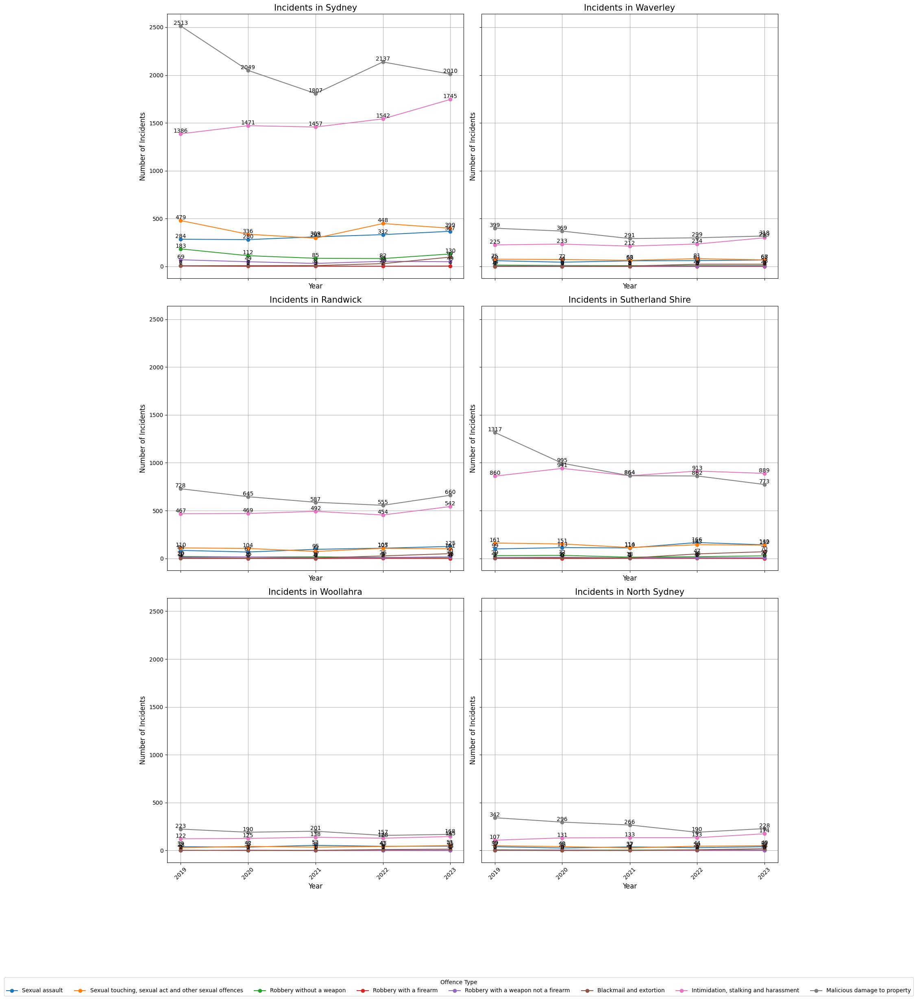

In [7]:
import matplotlib.dates as mdates


lgas_of_interest = ['Sydney', 'Waverley', 'Randwick', 'Sutherland Shire', 'Woollahra', 'North Sydney']
offense_types = [
    'Sexual assault', 'Sexual touching, sexual act and other sexual offences',
    'Robbery without a weapon', 'Robbery with a firearm', 
    'Robbery with a weapon not a firearm', 'Blackmail and extortion', 
    'Intimidation, stalking and harassment', 'Malicious damage to property'
]

filtered_crime_data = lga[
    (lga['Offence type'].isin(offense_types)) & 
    (lga['Local Government Area'].isin(lgas_of_interest))
]

melted_crime_data = pd.melt(filtered_crime_data, id_vars=['Local Government Area', 'Offence type'],
                            value_vars=['Jan - Dec 2019', 'Jan - Dec 2020', 'Jan - Dec 2021', 
                                        'Jan - Dec 2022', 'Jan - Dec 2023'],
                            var_name='Year', value_name='Incidents')

# Convert 'Year' to datetime
melted_crime_data['Year'] = pd.to_datetime(melted_crime_data['Year'].str[-4:])

#pivot_crime_data = melted_crime_data.pivot_table(index='Year', columns=['Local Government Area', 'Offence type'], values='Incidents', aggfunc='sum')

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(16, 24), sharex=True, sharey=True)
axes = axes.flatten()

for index, lga in enumerate(lgas_of_interest):
    ax = axes[index]
    lga_data = melted_crime_data[melted_crime_data['Local Government Area'] == lga]
    pivot_lga_data = lga_data.pivot_table(index='Year', columns='Offence type', values='Incidents', aggfunc='sum')

    for offense in offense_types:
        if offense in pivot_lga_data.columns:
            series = pivot_lga_data[offense]
            ax.plot(series.index, series, marker='o', linestyle='-', label=offense)
            # Annotate each data point with its value
            for i, value in enumerate(series):
                ax.text(series.index[i], value, f'{int(value)}', ha='center', va='bottom')

    ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    ax.set_title(f"Incidents in {lga}", fontsize=15)
    ax.set_xlabel("Year", fontsize=12)
    ax.set_ylabel("Number of Incidents", fontsize=12)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Adjust the layout to make space for the legend below the plots
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Collect handles and labels for the global legend
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=len(offense_types), title='Offence Type')

# Display the plots
plt.show()

In [8]:
#TOURIST PLACES
print("Tourist List shapes and columns:")
print(tourist.columns)
print(tourist.shape)
tourist

Tourist List shapes and columns:
Index(['tid', 'Tourist Place', 'Latitude', 'Longitude'], dtype='object')
(18, 4)


,tid,Tourist Place,Latitude,Longitude
0,1,Sydney Opera House,-33.856784,151.215293
1,2,Sydney Harbour Bridge,-33.852222,151.210833
2,3,Bondi Beach,-33.890542,151.274856
3,4,Royal Botanic Garden Sydney,-33.866534,151.218345
4,5,Taronga Zoo,-33.843235,151.240640
5,6,Darling Harbour,-33.874886,151.200775
6,7,The Rocks,-33.859035,151.208023
7,8,Manly Beach,-33.800383,151.287743
8,9,Coogee Beach,-33.923126,151.259129
9,10,Bronte Beach,-33.905618,151.265063


In [9]:
NSWTrends.columns

Index(['NSW Recorded Crime Statistics January 2019-December 2023',
       'Unnamed: 1', 'Unnamed: 2', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5',
       'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8'],
      dtype='object')

In [10]:
NSWTrends.head()

,NSW Recorded Crime Statistics January 2019-December 2023,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8
0,Incidents of crime recorded by the NSW Police ...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Offence type,Jan - Dec 2019,Jan - Dec 2020,Jan - Dec 2021,Jan - Dec 2022,Jan - Dec 2023,"Rate per 100,000 population Jan - Dec 2023",2 year trend and annual percent change (Jan 20...,5 year trend and average annual percent change...
3,Murder *,73,69,52,59,56,0.7,Stable,Down 6.4%
4,Attempted murder,26,27,19,13,14,0.2,nc,nc


In [11]:
print("Listings shapes and columns:")
print(listings.columns)
print(listings.shape)
listings.head()


Listings shapes and columns:
Index(['name', 'host_id', 'host_name', 'neighbourhood_group', 'neighbourhood',
       'latitude', 'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license'],
      dtype='object')
(14274, 17)


,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
id,,,,,,,,,,,,,,,,,
1050164598350388320,Self service English breakfast,211218678,Paul,NaN,Botany Bay,-33.924060,151.197320,Private room,100.0,1,0,NaN,NaN,1,268,0,PID-STRA-61891
1096082243192434668,Apartment in Rushcutters Bay,26721338,Anne,NaN,Sydney,-33.874830,151.225800,Entire home/apt,250.0,1,0,NaN,NaN,2,228,0,Exempt
2167538,"Modern Sydney home near beach,shops",11059668,Sophie,NaN,Waverley,-33.895820,151.245490,Entire home/apt,650.0,90,1,2015-04-01,0.01,1,365,0,NaN
790607305500629830,Luxury double room,202112801,Vivian,NaN,Canada Bay,-33.851626,151.086324,Private room,84.0,1,31,2024-03-07,2.13,30,365,26,PID-STRA-21723
641106357139201992,Chic Studio Apartment in Prime Bondi Location,279001183,MadeComfy,NaN,Waverley,-33.890550,151.275230,Entire home/apt,508.0,1,17,2023-02-19,0.84,217,0,0,PID-STRA-36651


In [12]:
print("listings in details")
print(listings_details.columns)
print(listings_details.shape)
listings_details.head()

listings in details
Index(['listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights

,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
id,,,,,,,,,,,,,,,,,,,,,
1050164598350388320,https://www.airbnb.com/rooms/1050164598350388320,20240316023820,2024-03-18,city scrape,Self service English breakfast,Close to transport airport older style unit ne...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,211218678,https://www.airbnb.com/users/show/211218678,...,NaN,NaN,NaN,PID-STRA-61891,f,1,0,1,0,NaN
1096082243192434668,https://www.airbnb.com/rooms/1096082243192434668,20240316023820,2024-03-18,city scrape,Apartment in Rushcutters Bay,Full 2 bedroom apartment with balcony. Walking...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,26721338,https://www.airbnb.com/users/show/26721338,...,NaN,NaN,NaN,Exempt,f,2,1,1,0,NaN
2167538,https://www.airbnb.com/rooms/2167538,20240316023820,2024-03-18,city scrape,"Modern Sydney home near beach,shops",**Availability extremely flexible**<br /><br /...,Queens Park is a safe and friendly neighbourho...,https://a0.muscache.com/pictures/29922910/2399...,11059668,https://www.airbnb.com/users/show/11059668,...,5.00,5.00,4.00,NaN,f,1,1,0,0,0.01
790607305500629830,https://www.airbnb.com/rooms/790607305500629830,20240316023820,2024-03-18,city scrape,Luxury double room,Relax in this tranquil and stylish space.,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,202112801,https://www.airbnb.com/users/show/202112801,...,4.77,4.68,4.68,PID-STRA-21723,f,30,5,25,0,2.13
641106357139201992,https://www.airbnb.com/rooms/641106357139201992,20240316023820,2024-03-18,city scrape,Chic Studio Apartment in Prime Bondi Location,Immerse yourself in the vibrant atmosphere of ...,Bondi is one of Australia’s most iconic suburb...,https://a0.muscache.com/pictures/prohost-api/H...,279001183,https://www.airbnb.com/users/show/279001183,...,3.94,4.94,4.29,PID-STRA-36651,f,217,217,0,0,0.84


In [13]:
print("reviews shapes and columns:")
print(reviews.columns)
print(reviews.shape)
reviews.head()


reviews shapes and columns:
Index(['date'], dtype='object')
(499595, 1)


,date
listing_id,
11156,2009-12-05
11156,2010-03-31
11156,2010-05-14
11156,2010-11-17
11156,2010-12-11


In [14]:
print("reviews in details")
print(reviews_details.columns)
print(reviews_details.shape)
reviews_details.head()

reviews in details
Index(['listing_id', 'id', 'date', 'reviewer_id', 'reviewer_name', 'comments'], dtype='object')
(499595, 6)


,listing_id,id,date,reviewer_id,reviewer_name,comments
0,11156,19220,2009-12-05,52946,Jeff,Colleen was friendly and very helpful regardin...
1,11156,32592,2010-03-31,99382,Michael,"Great place, centrally located, easy walk to t..."
2,11156,42280,2010-05-14,105797,Marina,Colleen is very friendly and helpful. The apar...
3,11156,140942,2010-11-17,259213,Sigrid,Dear Colleen!\r<br/>My friend Diemut from Germ...
4,11156,151966,2010-12-11,273389,Eduardo,"Lovely, interesting chats and very helpful giv..."


In [15]:
list_a = ['listing_url', 'scrape_id', 'last_scraped', 'source', 'name','description', 'neighborhood_overview', 'picture_url', 'host_id','host_url', 'host_name', 'host_since', 
          'host_location', 'host_about','host_response_time', 'host_response_rate', 'host_acceptance_rate','host_is_superhost', 'host_thumbnail_url', 'host_picture_url','host_neighbourhood', 
          'host_listings_count','host_total_listings_count', 'host_verifications','host_has_profile_pic', 'host_identity_verified', 'neighbourhood','neighbourhood_cleansed', 'neighbourhood_group_cleansed', 
          'latitude','longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms','bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price','minimum_nights', 'maximum_nights', 
          'minimum_minimum_nights','maximum_minimum_nights', 'minimum_maximum_nights','maximum_maximum_nights', 'minimum_nights_avg_ntm','maximum_nights_avg_ntm', 'calendar_updated', 'has_availability',
          'availability_30', 'availability_60', 'availability_90','availability_365', 'calendar_last_scraped', 'number_of_reviews','number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
          'last_review', 'review_scores_rating', 'review_scores_accuracy','review_scores_cleanliness', 'review_scores_checkin','review_scores_communication', 'review_scores_location',
          'review_scores_value', 'license', 'instant_bookable','calculated_host_listings_count','calculated_host_listings_count_entire_homes','calculated_host_listings_count_private_rooms',
          'calculated_host_listings_count_shared_rooms', 'reviews_per_month']

list_b = ['name', 'host_id', 'host_name', 'neighbourhood_group', 'neighbourhood','latitude', 'longitude', 'room_type', 'price', 
          'minimum_nights','number_of_reviews', 'last_review', 'reviews_per_month','calculated_host_listings_count', 'availability_365','number_of_reviews_ltm', 'license']

set_a = set(list_a)
set_b = set(list_b)
new_list = list(set_a - set_b)

print(new_list) 


['neighbourhood_cleansed', 'property_type', 'host_picture_url', 'maximum_minimum_nights', 'host_since', 'last_scraped', 'maximum_maximum_nights', 'calculated_host_listings_count_private_rooms', 'availability_60', 'host_is_superhost', 'amenities', 'host_response_time', 'review_scores_value', 'review_scores_checkin', 'availability_30', 'review_scores_accuracy', 'host_listings_count', 'neighbourhood_group_cleansed', 'host_total_listings_count', 'maximum_nights_avg_ntm', 'instant_bookable', 'first_review', 'minimum_minimum_nights', 'calculated_host_listings_count_shared_rooms', 'calendar_last_scraped', 'review_scores_rating', 'has_availability', 'minimum_maximum_nights', 'minimum_nights_avg_ntm', 'scrape_id', 'review_scores_location', 'host_neighbourhood', 'description', 'host_identity_verified', 'review_scores_communication', 'calendar_updated', 'host_thumbnail_url', 'host_response_rate', 'number_of_reviews_l30d', 'review_scores_cleanliness', 'source', 'accommodates', 'host_about', 'host_

MERGE LISTING AND LISTINGS_IN_DETAILS

In [16]:
listings = pd.merge(listings, listings_details[new_list], on='id', how='left')
listings.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood_group', 'neighbourhood',
       'latitude', 'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license', 'neighbourhood_cleansed',
       'property_type', 'host_picture_url', 'maximum_minimum_nights',
       'host_since', 'last_scraped', 'maximum_maximum_nights',
       'calculated_host_listings_count_private_rooms', 'availability_60',
       'host_is_superhost', 'amenities', 'host_response_time',
       'review_scores_value', 'review_scores_checkin', 'availability_30',
       'review_scores_accuracy', 'host_listings_count',
       'neighbourhood_group_cleansed', 'host_total_listings_count',
       'maximum_nights_avg_ntm', 'instant_bookable', 'first_review',
       'minimum_minimum_nights', 'calculated_host_listings_count_shared_rooms',
       'calendar_last_scraped', 'revie

In [17]:
#drop the missing values of the neighbourhood groups

listings = listings.drop(columns=['neighbourhood_group'])
listings['host_response_rate'] = pd.to_numeric(listings['host_response_rate'].str.strip('%'))

listings.head()

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,...,bathrooms,calculated_host_listings_count_entire_homes,host_verifications,beds,bedrooms,host_url,availability_90,maximum_nights,listing_url,neighborhood_overview
id,,,,,,,,,,,,,,,,,,,,,
1050164598350388320,Self service English breakfast,211218678,Paul,Botany Bay,-33.924060,151.197320,Private room,100.0,1,0,...,0.5,0,"['email', 'phone']",1.0,1.0,https://www.airbnb.com/users/show/211218678,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN
1096082243192434668,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.874830,151.225800,Entire home/apt,250.0,1,0,...,1.0,1,"['email', 'phone']",2.0,2.0,https://www.airbnb.com/users/show/26721338,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN
2167538,"Modern Sydney home near beach,shops",11059668,Sophie,Waverley,-33.895820,151.245490,Entire home/apt,650.0,90,1,...,2.0,1,"['email', 'phone']",3.0,3.0,https://www.airbnb.com/users/show/11059668,90,1125,https://www.airbnb.com/rooms/2167538,Queens Park is a safe and friendly neighbourho...
790607305500629830,Luxury double room,202112801,Vivian,Canada Bay,-33.851626,151.086324,Private room,84.0,1,31,...,1.0,5,"['email', 'phone']",1.0,1.0,https://www.airbnb.com/users/show/202112801,90,365,https://www.airbnb.com/rooms/790607305500629830,NaN
641106357139201992,Chic Studio Apartment in Prime Bondi Location,279001183,MadeComfy,Waverley,-33.890550,151.275230,Entire home/apt,508.0,1,17,...,1.0,217,"['email', 'phone', 'work_email']",1.0,1.0,https://www.airbnb.com/users/show/279001183,0,365,https://www.airbnb.com/rooms/641106357139201992,Bondi is one of Australia’s most iconic suburb...


In [18]:
listings.accommodates.head()

id
1050164598350388320    2
1096082243192434668    4
2167538                5
790607305500629830     1
641106357139201992     2
Name: accommodates, dtype: int64

In [19]:
listings['host_identity_verified'] = listings['host_identity_verified'].replace({'t': 'verified', 'f': 'unverified'})


1. Top 10 Neighbourhoods for Airbnb 

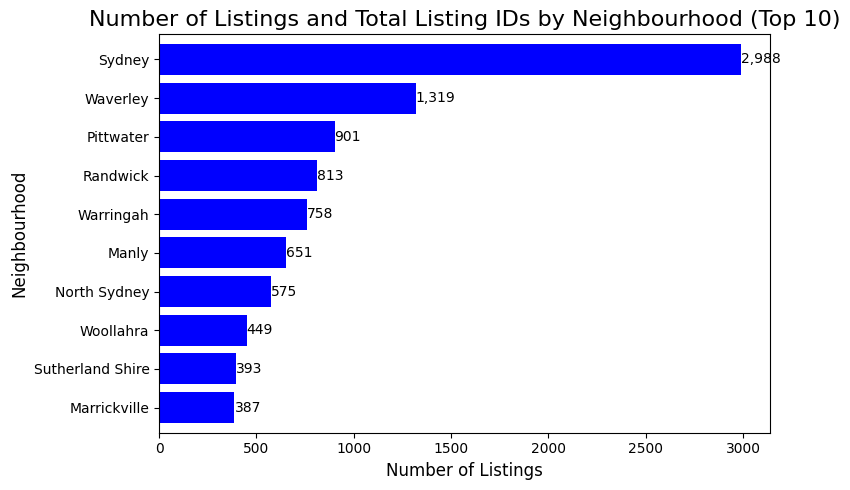

In [20]:
feq = listings['neighbourhood'].value_counts().sort_values(ascending=True)
top_10_feq = feq.tail(10)  # Get the top 10 neighborhoods with the most listings
total_listings_by_neighborhood = listings.groupby('neighbourhood')['calculated_host_listings_count'].count()  # Count the total occurrences of 'id' by neighborhood

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8)

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    neighborhood_name = top_10_feq.index[i]  # Get neighborhood name
    total_listings = total_listings_by_neighborhood.loc[neighborhood_name]
    ax.text(v + 0.1, i, f"{total_listings:,.0f}", va='center')  # Display total listings

plt.title("Number of Listings and Total Listing IDs by Neighbourhood (Top 10)", fontsize=16)
plt.xlabel('Number of Listings', fontsize=12)
plt.ylabel('Neighbourhood', fontsize=12)
plt.tight_layout()
plt.show()


In [21]:
listings.room_type.count()

14274

In [22]:
unique_host_count = listings['host_name'].nunique()
print( unique_host_count)

3293


In [23]:
ken_listings_count = listings[listings['host_name'] == 'Ken']['room_type'].count()
print(ken_listings_count)


157


**Daily Average Price in top 10 Neighborhoods**

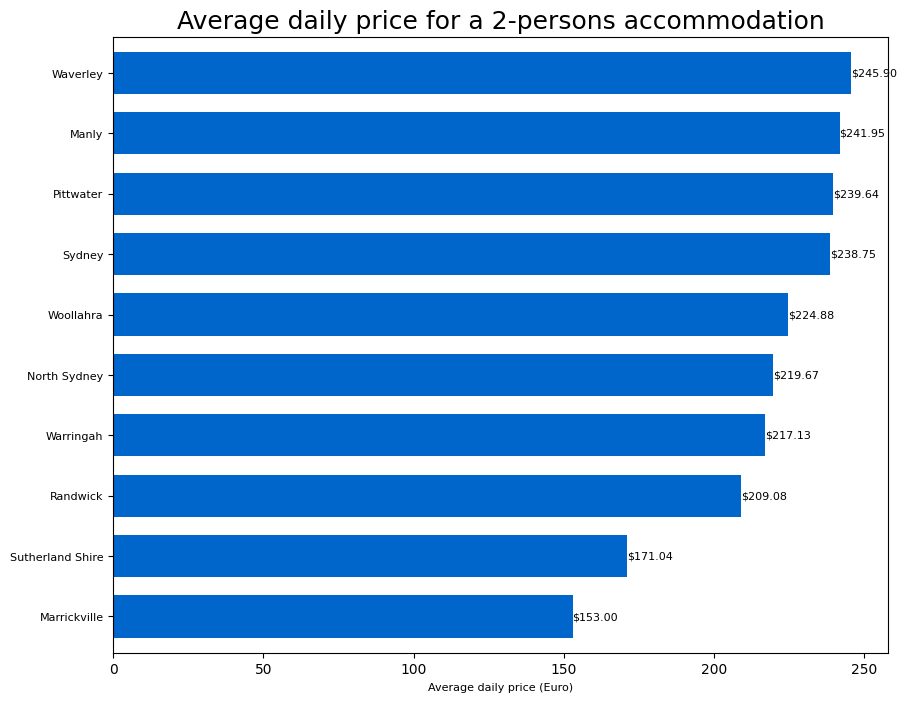

In [24]:
top_neighbourhoods = top_10_feq.index
filtered_listings = listings[listings['neighbourhood'].isin(top_neighbourhoods)]

feq = filtered_listings[filtered_listings['accommodates']==2]
feq = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
feq.plot.barh(figsize=(10, 8), color='#0066CC', width=0.7)
plt.title("Average daily price for a 2-persons accommodation", fontsize=18)
plt.xlabel('Average daily price (Euro)', fontsize=8)
plt.ylabel("")
plt.tick_params(axis='y', labelsize=8) 
for index, value in enumerate(feq):
    plt.text(value, index, f"${value:.2f}", va='center', color='black', fontsize=8)

plt.show()

In [25]:
#Heatmap of the price


Sydney is the most crowded neighbourhood with around 3,000 properties for the Airbnb purposes

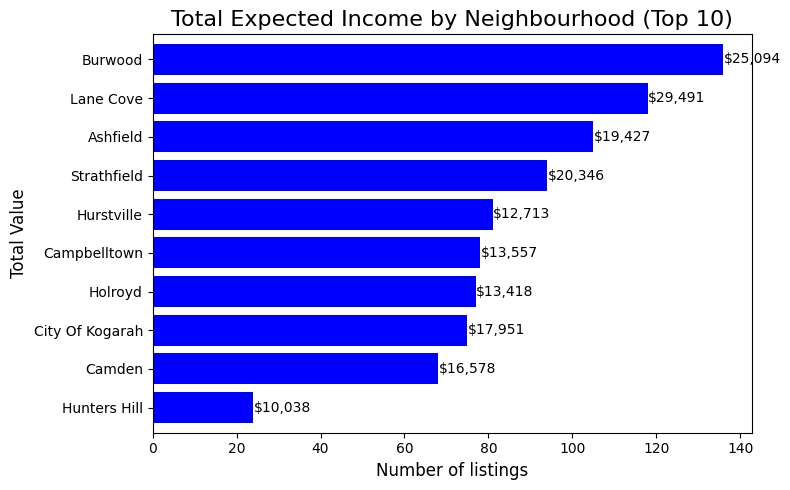

In [26]:
feq = listings['neighbourhood'].value_counts().sort_values(ascending=True)
top_10_feq = feq.head(10)
total_value_by_neighborhood = listings.groupby('neighbourhood')['price'].sum()

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8) 

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    neighborhood_name = top_10_feq.index[i]  # Get neighborhood name
    total_value = total_value_by_neighborhood.loc[neighborhood_name]
    ax.text(v + 0.1, i, f"${total_value:,.0f}", va='center')  # Adjust spacing and formatting 

plt.title("Total Expected Income by Neighbourhood (Top 10)", fontsize=16)
plt.xlabel('Number of listings', fontsize=12)
plt.ylabel('Total Value', fontsize=12) 
plt.tight_layout() 
plt.show()

**TOP 10 Neighbourhoods with the most income**

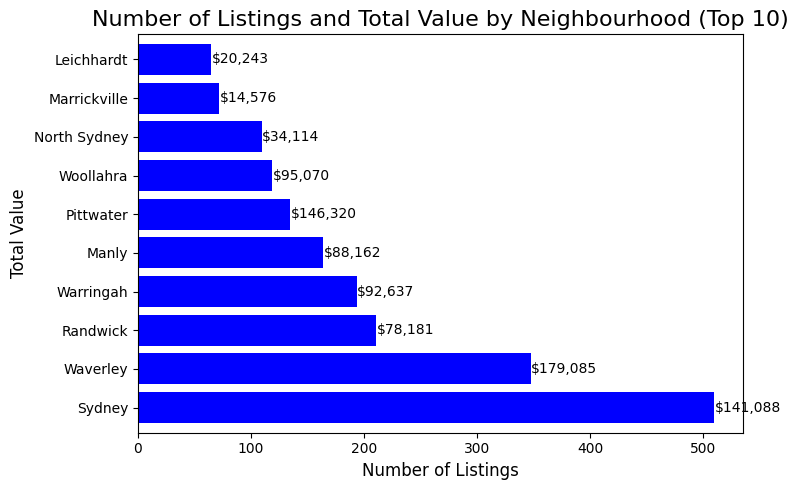

In [27]:
# For example, if you want to filter based on the 'availability_365' column:
unavailable_listings = listings[listings['availability_30'] == 0]

# Count the number of listings by neighbourhood
feq = unavailable_listings['neighbourhood'].value_counts().sort_values(ascending=False)
top_10_feq = feq.head(10)

# Calculate total value by neighbourhood using the filtered data
total_value_by_neighborhood = unavailable_listings.groupby('neighbourhood')['price'].sum()

# Plotting
fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8)

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    neighborhood_name = top_10_feq.index[i]  # Get neighbourhood name
    total_value = total_value_by_neighborhood.loc[neighborhood_name]
    ax.text(v + 0.1, i, f"${total_value:,.0f}", va='center')  # Adjust spacing and formatting

plt.title("Number of Listings and Total Value by Neighbourhood (Top 10)", fontsize=16)
plt.xlabel('Number of Listings', fontsize=12)
plt.ylabel('Total Value', fontsize=12)
plt.tight_layout()
plt.show()



**The Neighbourhood Map**

In [28]:
lats = tourist['Latitude'].tolist()
lons = tourist['Longitude'].tolist()
tp = tourist['Tourist Place'].tolist()

	
map1 = folium.Map(location=[-33.90568, 151.2093], zoom_start=11.5)
marker_cluster = MarkerCluster().add_to(map1)


for lat, lon, tp in zip(lats, lons, tp):
    popup_content = f"Tourist Place: {tp}"
    popup = folium.Popup(popup_content, max_width=300)
    

    folium.Marker(location=[lat, lon], popup=popup).add_to(marker_cluster)

map1

the original code with the explanation-
import matplotlib.pyplot as plt

feq = listings['neighbourhood'].value_counts().sort_values(ascending=True)
top_10_feq = feq.head(10)

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8) 

for i, v in enumerate(top_10_feq):
    neighborhood_name = top_10_feq.index[i]  # Get neighborhood name
    total_value = total_value_by_neighborhood.loc[neighborhood_name]
    ax.text(v + 0.1, i, f"${total_value:,.0f}", va='center')  # Adjust spacing and formatting 

plt.title("Number of listings and Total Value by Neighbourhood (Top 10)", fontsize=16)
plt.xlabel('Number of listings', fontsize=12)
plt.ylabel('Total Value', fontsize=12) 
plt.tight_layout() 
plt.show()


In [29]:
lats = listings['latitude'].tolist()
lons = listings['longitude'].tolist()
host_names = listings['host_name'].tolist()
room_types = listings['room_type'].tolist()
licenses = listings['license'].tolist()
verify = listings['host_identity_verified'].tolist()
review_scores_rating = listings['review_scores_rating'].fillna(0).tolist()  # Assuming you want to fill NA/NaN values with 0

map1 = folium.Map(location=[-33.90568, 151.2093], zoom_start=11.5)
marker_cluster = MarkerCluster().add_to(map1)


for lat, lon, host_name, room_type, license, verify, rpm in zip(lats, lons, host_names, room_types, licenses, verify, review_scores_rating):
    popup_content = f"Host Name: {host_name}<br>Room Type: {room_type}<br>License: {license}<br>Verified Host: {verify}<br>Reviews per Month: {rpm}"
    popup = folium.Popup(popup_content, max_width=300)
    

    folium.Marker(location=[lat, lon], popup=popup).add_to(marker_cluster)

map1


2. Room types 

In [30]:
room_type_unique = listings['room_type'].unique()
print(room_type_unique)

['Private room' 'Entire home/apt' 'Shared room' 'Hotel room']


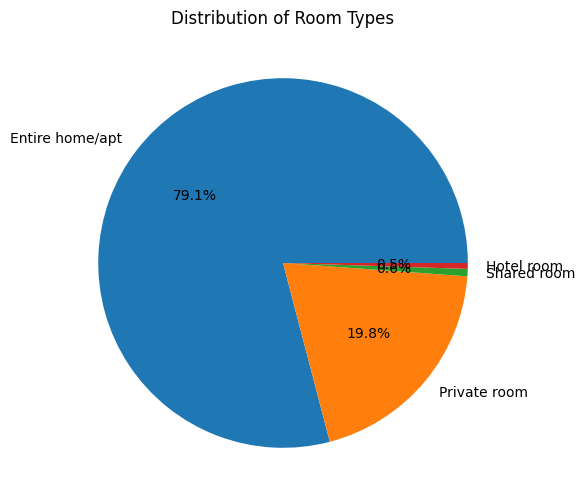

In [31]:
room_type_counts = listings['room_type'].value_counts()
plt.figure(figsize=(8, 6))  

plt.pie(room_type_counts, labels= room_type_counts.index, autopct="%1.1f%%", 
        textprops={'fontsize': 10})
plt.title("Distribution of Room Types")
plt.show()

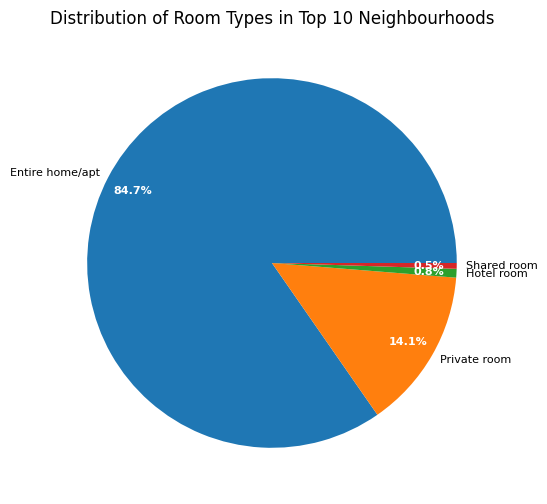

In [32]:
#the top 10 neighbourhoods rentals

top_neighbourhoods = top_10_feq.index
filtered_listings = listings[listings['neighbourhood'].isin(top_neighbourhoods)]

# Now, calculate room type counts within these top neighbourhoods
room_type_counts_filtered = filtered_listings['room_type'].value_counts()

def autopct_format(values):
    def my_format(pct):
        return '{:.1f}%'.format(pct)
    return my_format(values)

plt.figure(figsize=(8, 6))
plt.pie(room_type_counts_filtered, labels=room_type_counts_filtered.index, 
        autopct=lambda pct: f'{pct:.1f}%',  # Formatting for percentages
        textprops={'fontsize': 8},  # Default text properties for labels
        pctdistance=0.85, labeldistance=1.05)
plt.title("Distribution of Room Types in Top 10 Neighbourhoods")
# To style percentage text, use a separate call to adjust properties after creating the pie chart
for text in plt.gca().texts:
    if '%' in text.get_text():
        text.set_color('white')
        text.set_weight('bold')
plt.show()



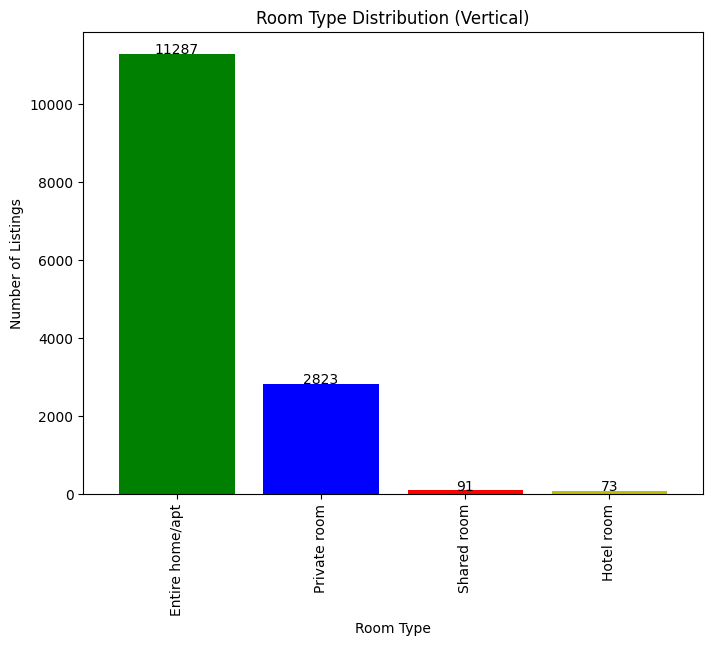

In [33]:
# Get frequency counts (you might already have this)
freq = listings['room_type'].value_counts().sort_values(ascending=False)

# Create the vertical bar chart (switch from 'barh' to 'bar')
freq.plot.bar(figsize=(8, 6), width=0.8, color=["g", "b", "r", "y"]) 


for i, v in enumerate(freq):
    plt.text(i, v + 5, str(v), ha='center')  

plt.title("Room Type Distribution (Vertical)")
plt.ylabel("Number of Listings")
plt.xlabel("Room Type")
plt.show()

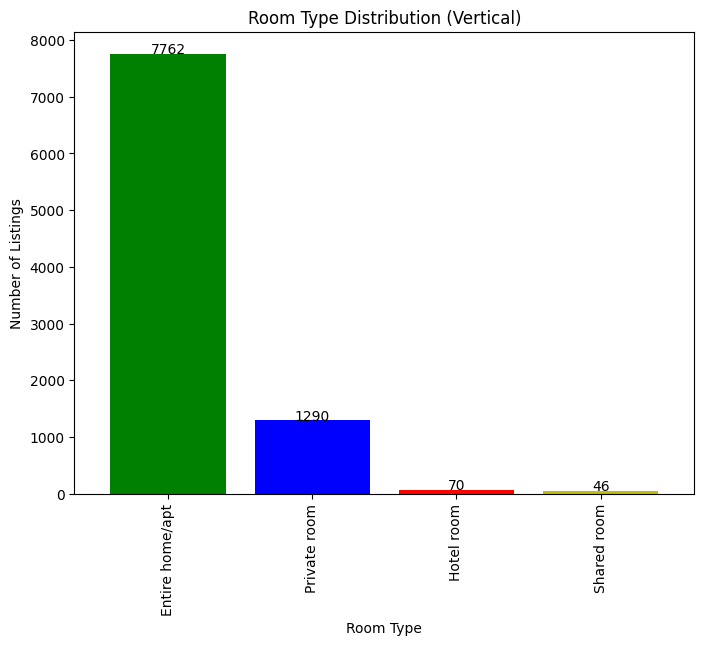

In [34]:
#the top 10 neighbourhoods rentals

# Create the vertical bar chart (switch from 'barh' to 'bar')
room_type_counts_filtered.plot.bar(figsize=(8, 6), width=0.8, color=["g", "b", "r", "y"]) 


for i, v in enumerate(room_type_counts_filtered):
    plt.text(i, v + 5, str(v), ha='center')  

plt.title("Room Type Distribution (Vertical)")
plt.ylabel("Number of Listings")
plt.xlabel("Room Type")
plt.show()

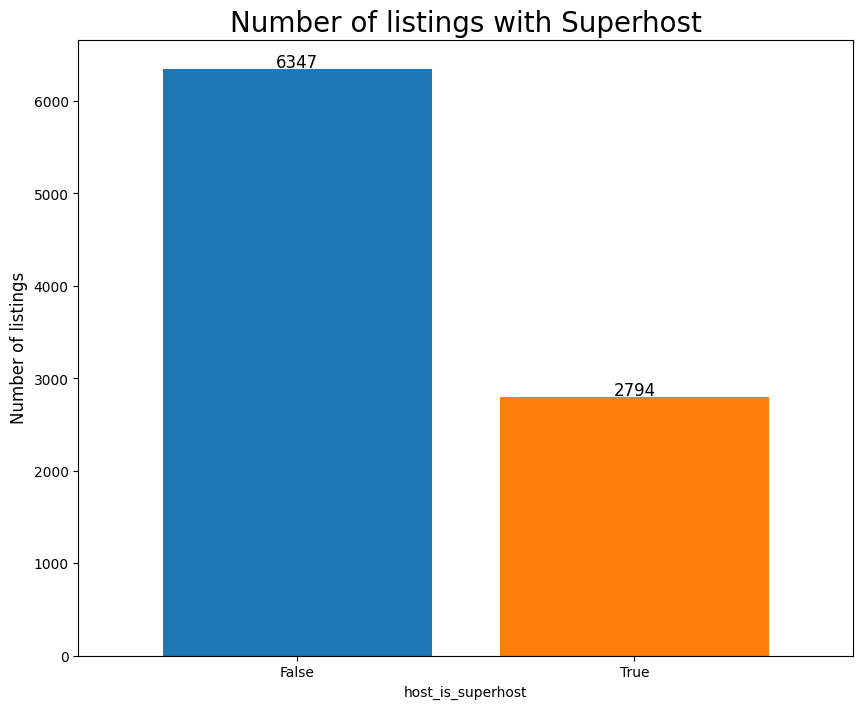

In [35]:
filtered_listings.host_is_superhost = filtered_listings.host_is_superhost.replace({"t": "True", "f": "False"})

feq=filtered_listings['host_is_superhost'].value_counts()
ax = feq.plot.bar(figsize=(10, 8), width=0.8, rot=0, color=['#1f77b4', '#ff7f0e'])

plt.title("Number of listings with Superhost", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)

# Add text labels above the bars.
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

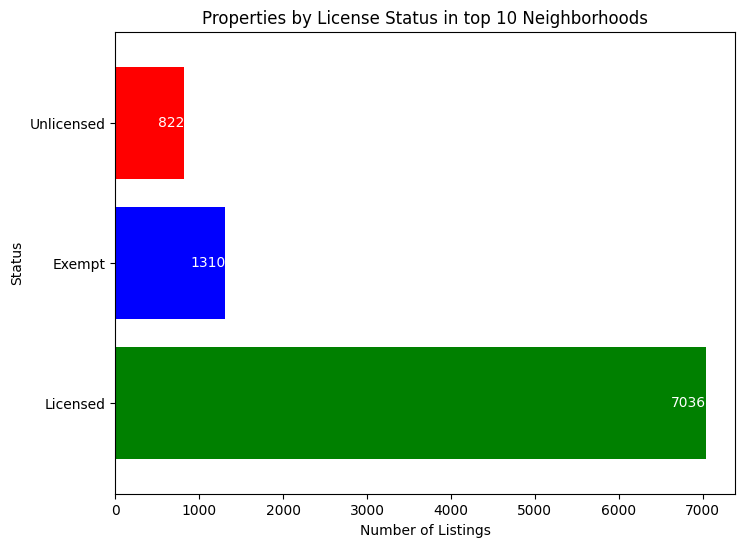

In [36]:
licensed_count = filtered_listings['license'].str.startswith("PID-STRA-").sum()
exempt_count = filtered_listings['license'].str.startswith("Exempt").sum()


unlicensed_count = filtered_listings.shape[0] - licensed_count - exempt_count


counts = pd.Series([licensed_count, exempt_count, unlicensed_count], index=["Licensed", "Exempt", "Unlicensed"])

counts.plot.barh(figsize=(8, 6), width=0.8, color=["g", "b", "r"])


for index, value in enumerate(counts):
    plt.text(value, index, str(value), color = "#ffffff", ha='right', va='center')

plt.title("Properties by License Status in top 10 Neighborhoods")
plt.xlabel("Number of Listings")
plt.ylabel("Status")
plt.show()

**The number of accomodates in top 10 neighborhoods**

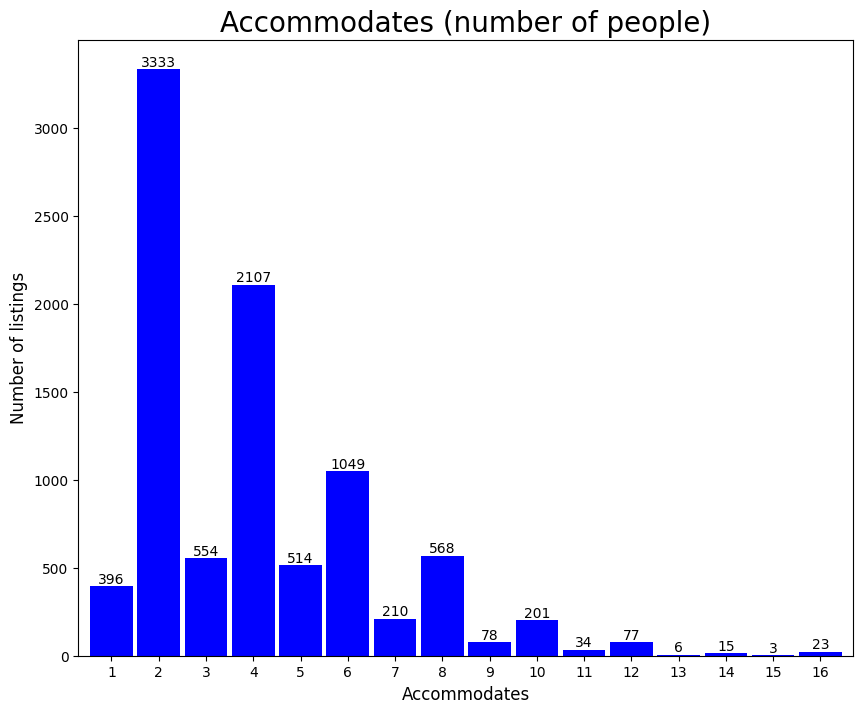

In [37]:
feq=filtered_listings['accommodates'].value_counts().sort_index()
ax= feq.plot.bar(figsize=(10, 8), color='b', width=0.9, rot=0)
plt.title("Accommodates (number of people)", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Accommodates', fontsize=12)

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2., p.get_height(), int(p.get_height()), 
            ha='center', va='bottom', color='black', fontsize=10)
    
plt.show()

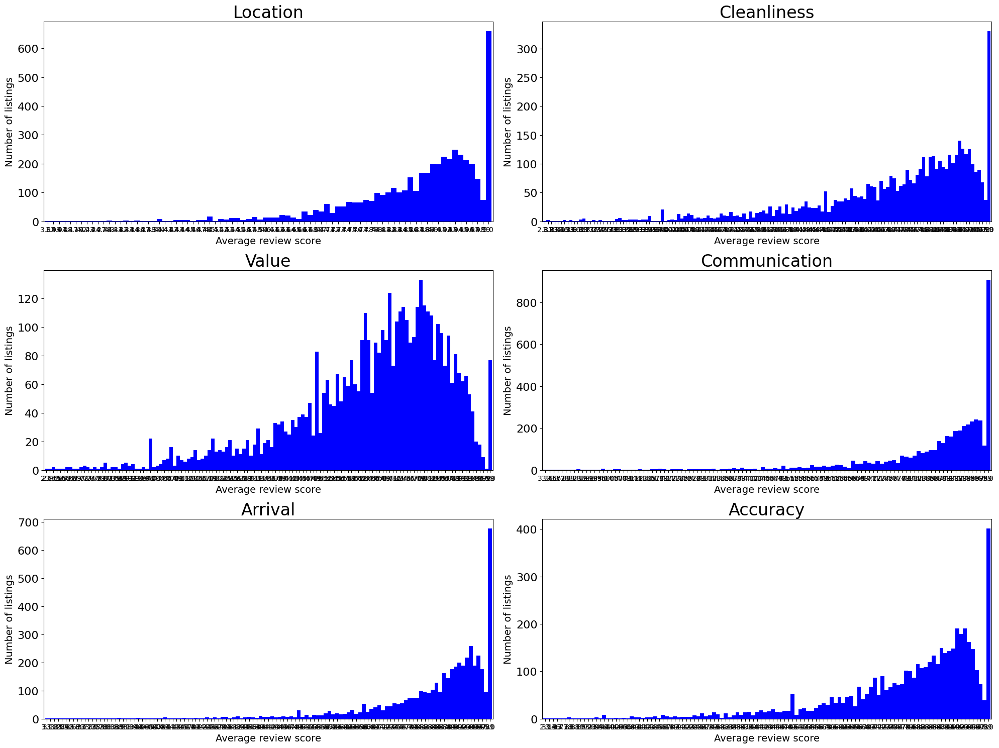

In [38]:
listings10 = filtered_listings[filtered_listings['number_of_reviews']>=10]

fig = plt.figure(figsize=(20,15))
plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=16)

ax1 = fig.add_subplot(321)
feq=listings10['review_scores_location'].value_counts().sort_index()
ax1=feq.plot.bar(color='b', width=1, rot=0)
#ax1.tick_params(axis = 'both', labelsize = 16)
plt.title("Location", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax2 = fig.add_subplot(322)
feq=listings10['review_scores_cleanliness'].value_counts().sort_index()
ax2=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Cleanliness", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax3 = fig.add_subplot(323)
feq=listings10['review_scores_value'].value_counts().sort_index()
ax3=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Value", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax4 = fig.add_subplot(324)
feq=listings10['review_scores_communication'].value_counts().sort_index()
ax4=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Communication", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax5 = fig.add_subplot(325)
feq=listings10['review_scores_checkin'].value_counts().sort_index()
ax5=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Arrival", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax6 = fig.add_subplot(326)
feq=listings10['review_scores_accuracy'].value_counts().sort_index()
ax6=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Accuracy", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)




plt.tight_layout()
plt.show()

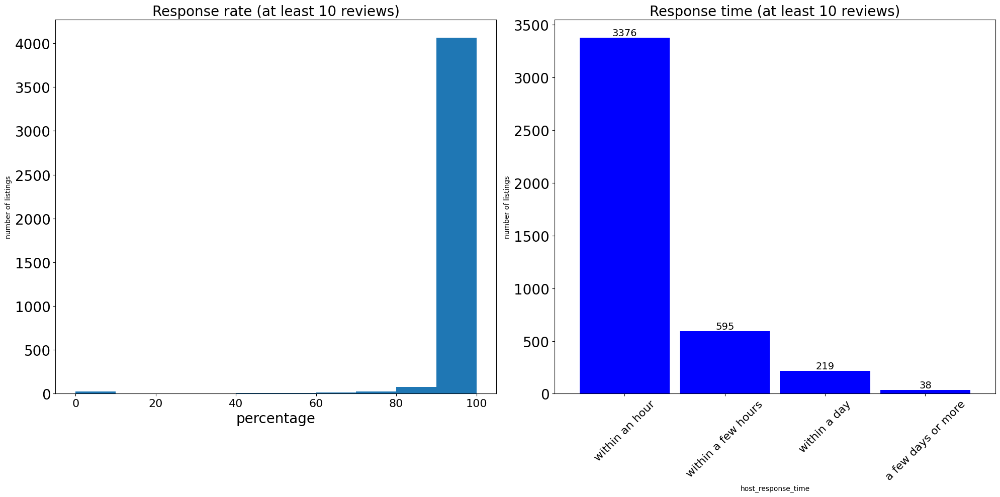

In [39]:
fig = plt.figure(figsize=(20,10))
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=20)

ax1 = fig.add_subplot(121)
feq1 = listings10['host_response_rate'].dropna()
ax1= plt.hist(feq1)
plt.title("Response rate (at least 10 reviews)", fontsize=20)
plt.ylabel("number of listings")
plt.xlabel("percentage", fontsize=20)

ax2 = fig.add_subplot(122)
feq2 = listings10['host_response_time'].value_counts()
ax2=feq2.plot.bar(color='b', width=0.9, rot=45)
plt.title("Response time (at least 10 reviews)", fontsize=20)
plt.ylabel("number of listings")
for i, value in enumerate(feq2):
    ax2.text(i, value, f'{value}', ha='center', va='bottom', fontsize=14)

plt.tight_layout()
plt.show()

**the minimumn and maxiumum nights**

In [40]:
filtered_listings.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license', 'neighbourhood_cleansed',
       'property_type', 'host_picture_url', 'maximum_minimum_nights',
       'host_since', 'last_scraped', 'maximum_maximum_nights',
       'calculated_host_listings_count_private_rooms', 'availability_60',
       'host_is_superhost', 'amenities', 'host_response_time',
       'review_scores_value', 'review_scores_checkin', 'availability_30',
       'review_scores_accuracy', 'host_listings_count',
       'neighbourhood_group_cleansed', 'host_total_listings_count',
       'maximum_nights_avg_ntm', 'instant_bookable', 'first_review',
       'minimum_minimum_nights', 'calculated_host_listings_count_shared_rooms',
       'calendar_last_scraped', 'review_scores_rating', 'has_

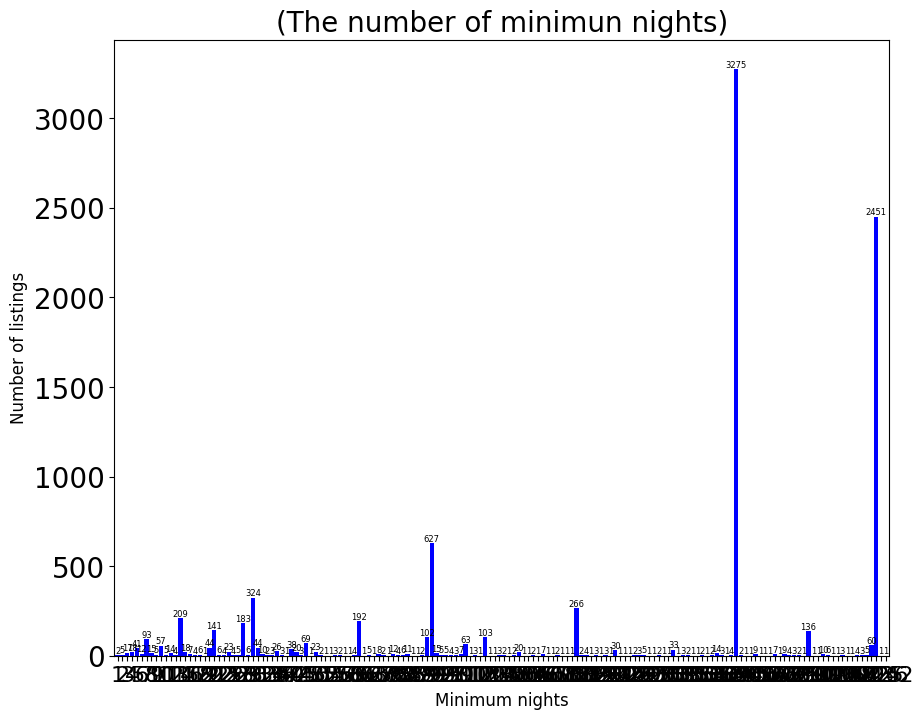

In [41]:
feq=filtered_listings['maximum_nights'].value_counts().sort_index()
ax= feq.plot.bar(figsize=(10, 8), color='b', width=0.9, rot=0)
plt.title("(The number of minimun nights)", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Minimum nights', fontsize=12)

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2., p.get_height(), int(p.get_height()), 
            ha='center', va='bottom', color='black', fontsize=6)
    
plt.show()

**The rest of the listings in the other neighborhoods**

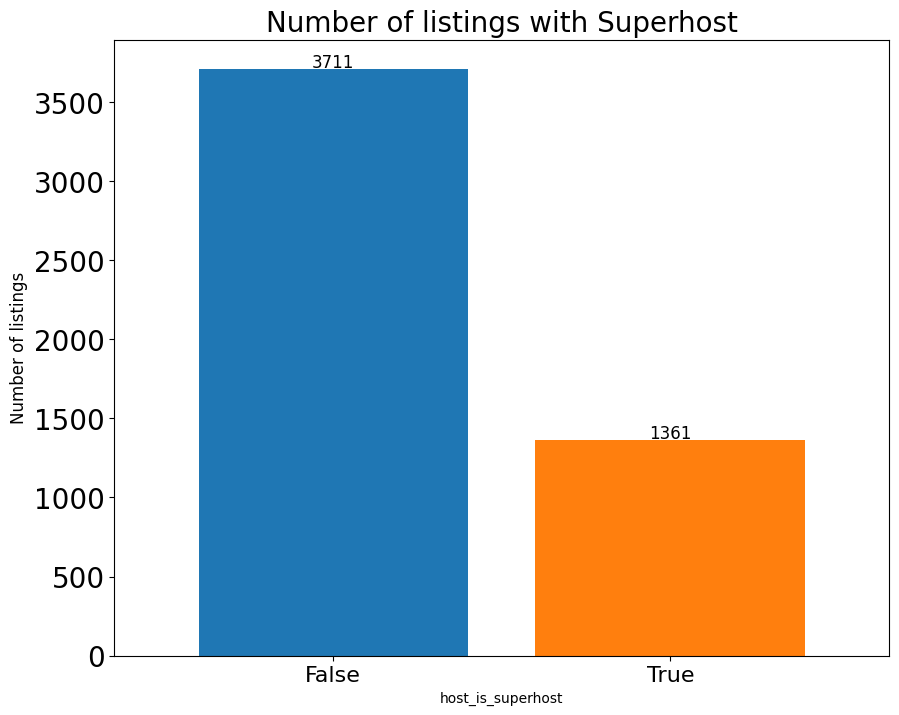

In [42]:
# Assuming listings is your original DataFrame and top_neighbourhoods is a list of neighbourhood names
rest_of_listings = listings[~listings['neighbourhood'].isin(top_neighbourhoods)]

rest_of_listings.host_is_superhost = rest_of_listings.host_is_superhost.replace({"t": "True", "f": "False"})

feq=rest_of_listings['host_is_superhost'].value_counts()
ax = feq.plot.bar(figsize=(10, 8), width=0.8, rot=0, color=['#1f77b4', '#ff7f0e'])

plt.title("Number of listings with Superhost", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)

# Add text labels above the bars.
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()


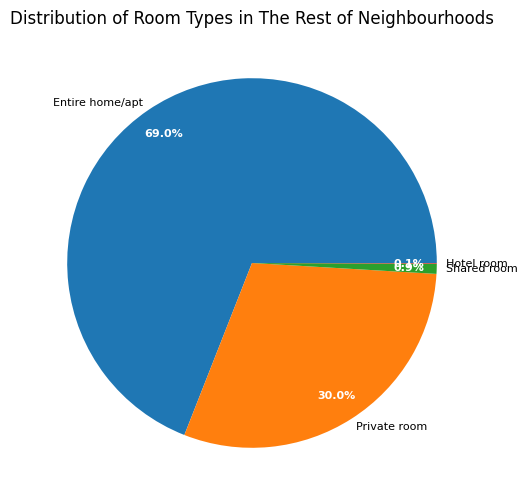

In [43]:
#the top 10 neighbourhoods rentals

#top_neighbourhoods = top_10_feq.index
#filtered_listings = listings[listings['neighbourhood'].isin(top_neighbourhoods)]

# Now, calculate room type counts within these top neighbourhoods
room_type_counts_filtered = rest_of_listings['room_type'].value_counts()

def autopct_format(values):
    def my_format(pct):
        return '{:.1f}%'.format(pct)
    return my_format(values)

plt.figure(figsize=(8, 6))
plt.pie(room_type_counts_filtered, labels=room_type_counts_filtered.index, 
        autopct=lambda pct: f'{pct:.1f}%',  # Formatting for percentages
        textprops={'fontsize': 8},  # Default text properties for labels
        pctdistance=0.85, labeldistance=1.05)
plt.title("Distribution of Room Types in The Rest of Neighbourhoods")
# To style percentage text, use a separate call to adjust properties after creating the pie chart
for text in plt.gca().texts:
    if '%' in text.get_text():
        text.set_color('white')
        text.set_weight('bold')
plt.show()

**The Lincese Status of listings in the rest of neighborhoods**

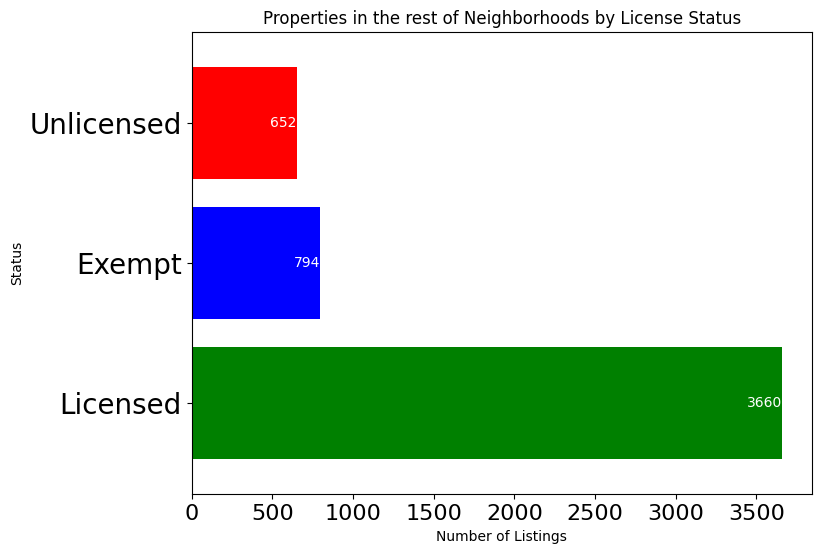

In [44]:
licensed_count = rest_of_listings['license'].str.startswith("PID-STRA-").sum()
exempt_count = rest_of_listings['license'].str.startswith("Exempt").sum()


unlicensed_count = rest_of_listings.shape[0] - licensed_count - exempt_count


counts = pd.Series([licensed_count, exempt_count, unlicensed_count], index=["Licensed", "Exempt", "Unlicensed"])

counts.plot.barh(figsize=(8, 6), width=0.8, color=["g", "b", "r"])


for index, value in enumerate(counts):
    plt.text(value, index, str(value), color = "#ffffff", ha='right', va='center')

plt.title("Properties in the rest of Neighborhoods by License Status")
plt.xlabel("Number of Listings")
plt.ylabel("Status")
plt.show()

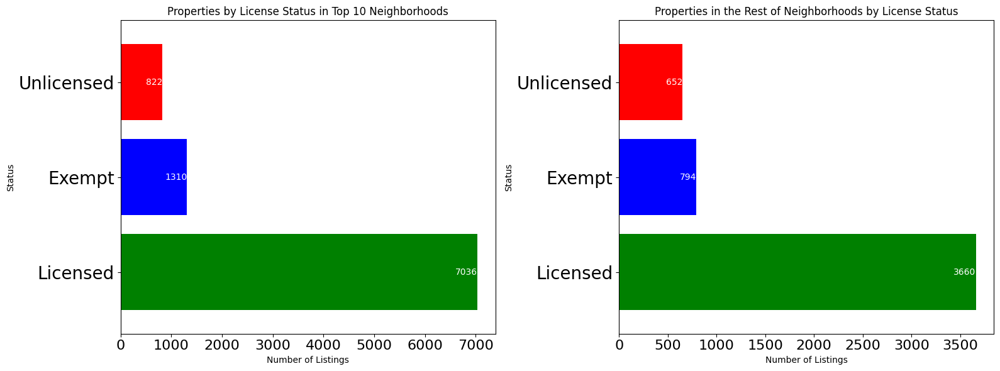

In [45]:
licensed_count_top10 = filtered_listings['license'].str.startswith("PID-STRA-").sum()
exempt_count_top10 = filtered_listings['license'].str.startswith("Exempt").sum()
unlicensed_count_top10 = filtered_listings.shape[0] - licensed_count_top10 - exempt_count_top10
counts_top10 = pd.Series([licensed_count_top10, exempt_count_top10, unlicensed_count_top10], index=["Licensed", "Exempt", "Unlicensed"])

# Prepare data for the second plot (rest of neighborhoods)
licensed_count_rest = rest_of_listings['license'].str.startswith("PID-STRA-").sum()
exempt_count_rest = rest_of_listings['license'].str.startswith("Exempt").sum()
unlicensed_count_rest = rest_of_listings.shape[0] - licensed_count_rest - exempt_count_rest
counts_rest = pd.Series([licensed_count_rest, exempt_count_rest, unlicensed_count_rest], index=["Licensed", "Exempt", "Unlicensed"])

# Create a figure with two subplots side by side
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

# Plot for top 10 neighborhoods
counts_top10.plot.barh(ax=axes[0], width=0.8, color=["g", "b", "r"])
axes[0].set_title("Properties by License Status in Top 10 Neighborhoods")
axes[0].set_xlabel("Number of Listings")
axes[0].set_ylabel("Status")
# Add text annotations
for index, value in enumerate(counts_top10):
    axes[0].text(value, index, str(value), color = "#ffffff", ha='right', va='center')

# Plot for the rest of neighborhoods
counts_rest.plot.barh(ax=axes[1], width=0.8, color=["g", "b", "r"])
axes[1].set_title("Properties in the Rest of Neighborhoods by License Status")
axes[1].set_xlabel("Number of Listings")
axes[1].set_ylabel("Status")
# Add text annotations
for index, value in enumerate(counts_rest):
    axes[1].text(value, index, str(value), color = "#ffffff", ha='right', va='center')

# Adjust layout
plt.tight_layout()

# Display the plots
plt.show()


**MadeComfy**

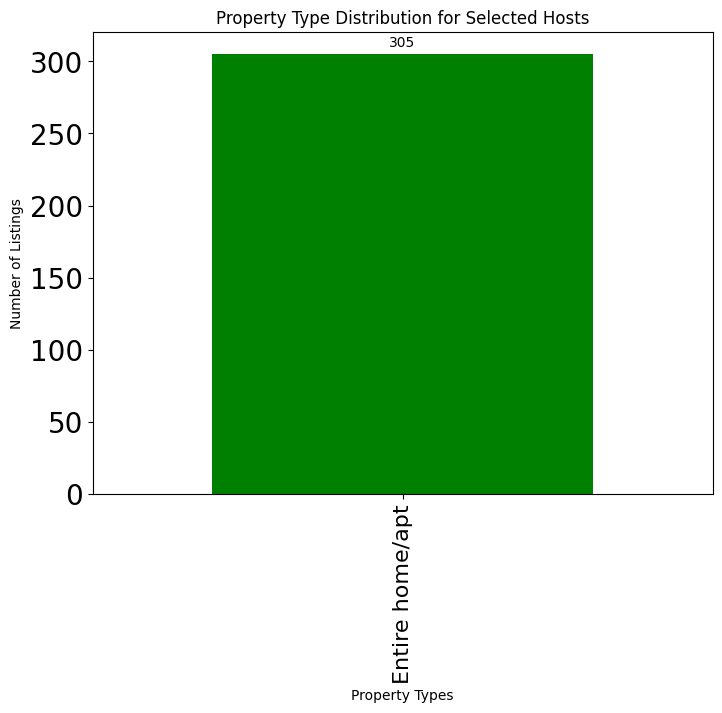

In [46]:
hosts_listings = filtered_listings[(filtered_listings['host_name'] == "MadeComfy") | (filtered_listings['host_name'] == "L'Abode Accommodation Specialist")]

# Calculate room type counts within these filtered listings
room_type_counts_hosts = hosts_listings['room_type'].value_counts()

# Create the vertical bar chart
room_type_counts_hosts.plot.bar(figsize=(8, 6), width=0.8, color=["g", "b", "r", "y"])

# Add value labels above the bars
for i, v in enumerate(room_type_counts_hosts):
    plt.text(i, v + 5, str(v), ha='center')

plt.title("Property Type Distribution for Selected Hosts")
plt.ylabel("Number of Listings")
plt.xlabel("Property Types")
plt.show()


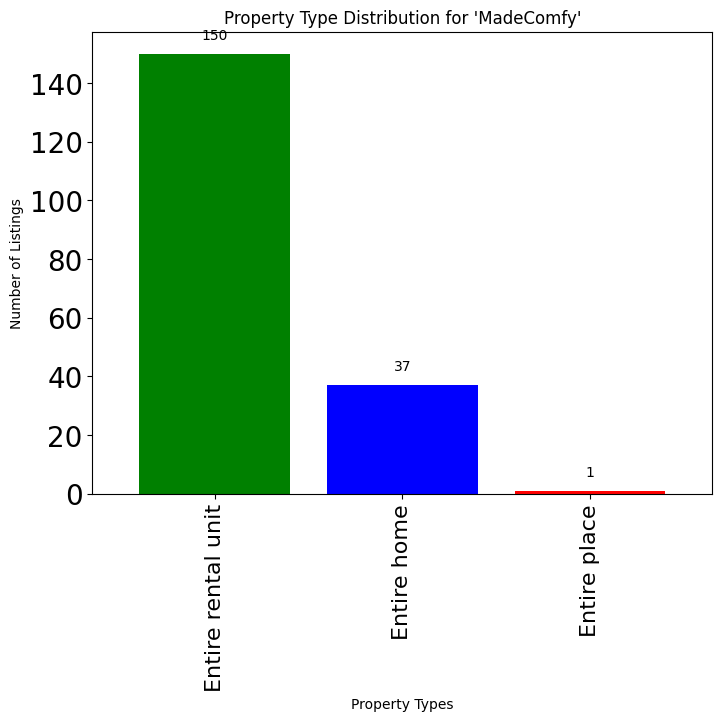

In [47]:

# Filter 'filtered_listings' for listings with 'host_name' equal to "MadeComfy"
made_comfy_listings = filtered_listings[filtered_listings['host_name'] == "MadeComfy"]

# Now, calculate room type counts within these filtered listings
room_type_counts_made_comfy = made_comfy_listings['property_type'].value_counts()

# Create the vertical bar chart for "MadeComfy"
room_type_counts_made_comfy.plot.bar(figsize=(8, 6), width=0.8, color=["g", "b", "r", "y"])

# Add value labels above the bars
for i, v in enumerate(room_type_counts_made_comfy):
    plt.text(i, v + 5, str(v), ha='center')  

plt.title("Property Type Distribution for 'MadeComfy'")
plt.ylabel("Number of Listings")
plt.xlabel("Property Types")
plt.show()


****

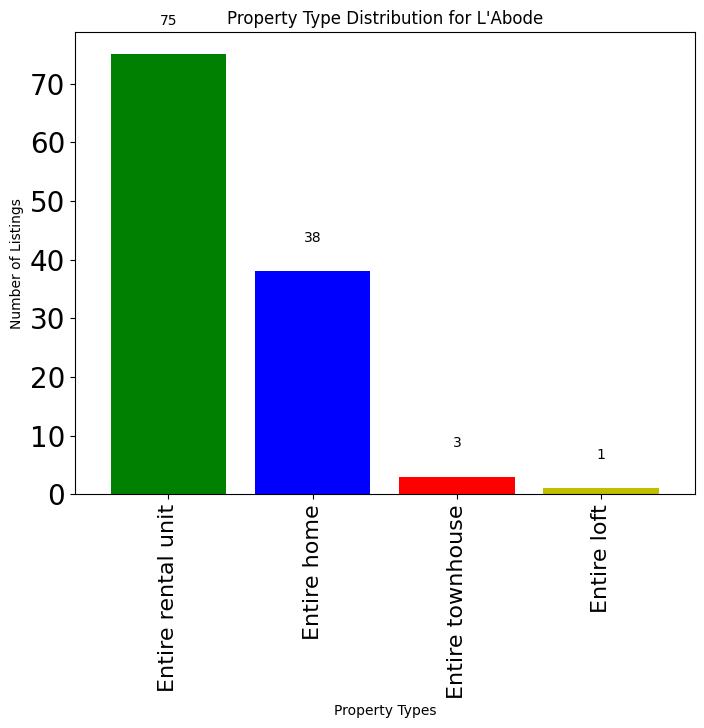

In [48]:

# Filter 'filtered_listings' for listings with 'host_name' equal to "MadeComfy"
labode_listings = filtered_listings[filtered_listings['host_name'] == "L'Abode Accommodation Specialist"]

# Now, calculate room type counts within these filtered listings
room_type_counts_labode = labode_listings['property_type'].value_counts()

# Create the vertical bar chart for "MadeComfy"
room_type_counts_labode.plot.bar(figsize=(8, 6), width=0.8, color=["g", "b", "r", "y"])

# Add value labels above the bars
for i, v in enumerate(room_type_counts_labode):
    plt.text(i, v + 5, str(v), ha='center')  

plt.title("Property Type Distribution for L'Abode")
plt.ylabel("Number of Listings")
plt.xlabel("Property Types")
plt.show()

**The number of accomodates in rest of neighborhoods**

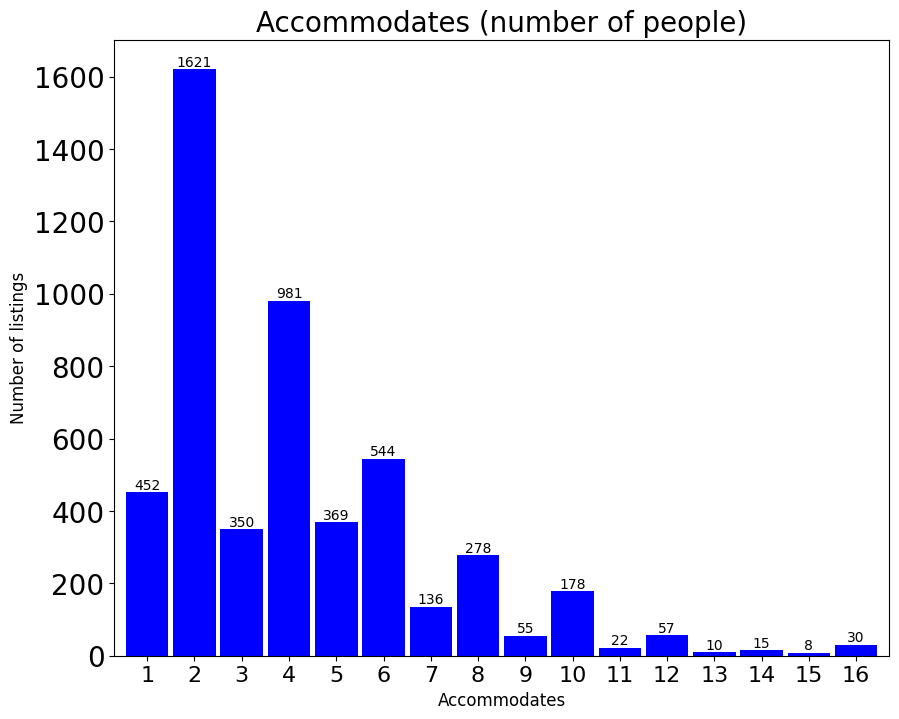

In [49]:
feq=rest_of_listings['accommodates'].value_counts().sort_index()
ax = feq.plot.bar(figsize=(10, 8), color='b', width=0.9, rot=0)
plt.title("Accommodates (number of people)", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Accommodates', fontsize=12)

for p in ax.patches:
    ax.text(p.get_x() + p.get_width() / 2., p.get_height(), int(p.get_height()), 
            ha='center', va='bottom', color='black', fontsize=10)
    
plt.show()

**Top 10 Host in top 10 neighboorhoods with the most reviews**

In [50]:
top_hosts = filtered_listings.groupby('host_name')['number_of_reviews'].sum().sort_values(ascending=False).head(10)
top_hosts


host_name
MadeComfy     5500
Michael       3958
Tommy         2985
Emma          2968
Susan         2899
Annie         2707
Dom           2595
Gabriel HH    2541
David         2506
Ween          2487
Name: number_of_reviews, dtype: int64

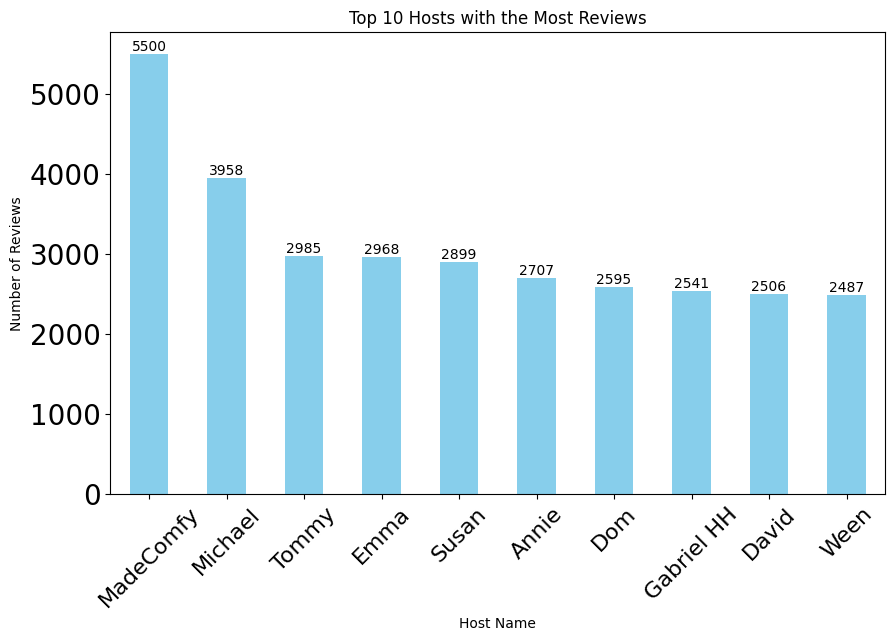

In [51]:
top_hosts.plot(kind='bar', figsize=(10, 6), color='skyblue')
plt.title('Top 10 Hosts with the Most Reviews')
plt.xlabel('Host Name')
plt.ylabel('Number of Reviews')
plt.xticks(rotation=45)

# Annotating each bar with its value
for index, value in enumerate(top_hosts):
    plt.text(index, value, str(value), ha='center', va='bottom')

plt.show()


In [52]:
top_hostsL = filtered_listings['host_name'].value_counts().nlargest(10)
top_hostsL

host_name
MadeComfy                           188
L'Abode Accommodation Specialist    117
Hotelesque                          100
Palm Beach Holiday Rentals           88
Megan                                72
Michael                              64
The Apartment Service                63
Gabriel HH                           57
Sarah                                55
Julie                                55
Name: count, dtype: int64

In [53]:
host_review_stats = filtered_listings.groupby('host_name').agg({
    'review_scores_value': 'mean',
    'number_of_reviews': 'sum'
})

top_hosts_review_stats = host_review_stats.loc[top_hostsL.index]

top_hosts_review_stats = top_hosts_review_stats.reset_index()

top_hosts_review_stats


,host_name,review_scores_value,number_of_reviews
0,MadeComfy,4.257528,5500
1,L'Abode Accommodation Specialist,4.514941,1307
2,Hotelesque,4.549639,1068
3,Palm Beach Holiday Rentals,4.473333,87
4,Megan,4.479825,1908
5,Michael,4.748036,3958
6,The Apartment Service,4.098596,543
7,Gabriel HH,4.521429,2541
8,Sarah,4.768667,1744
9,Julie,4.703333,2181


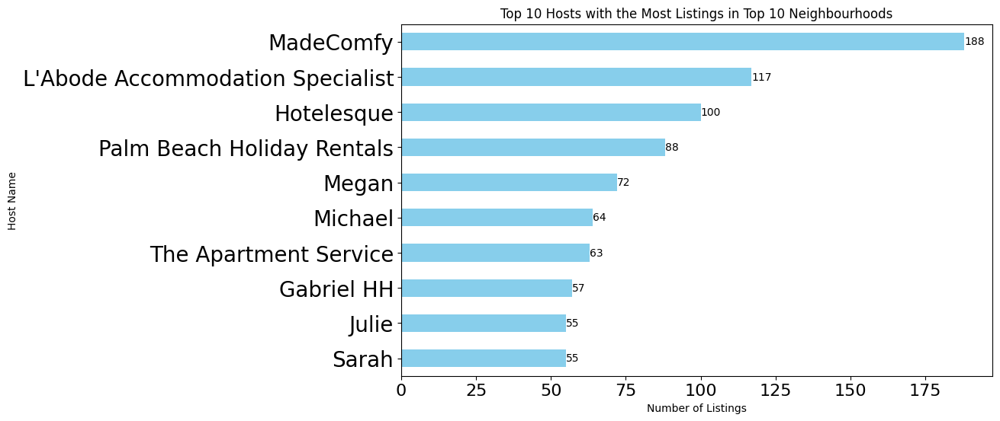

In [54]:
top_hostsL_sorted = top_hostsL.sort_values(ascending=True)

# Plotting the sorted data
top_hostsL_sorted.plot(kind='barh', figsize=(10, 6), color='skyblue')
plt.title('Top 10 Hosts with the Most Listings in Top 10 Neighbourhoods')
plt.xlabel('Number of Listings')
plt.ylabel('Host Name')

# Annotating each bar with its value
for index, value in enumerate(top_hostsL_sorted):
    plt.text(value, index, str(value), va='center')

plt.show()



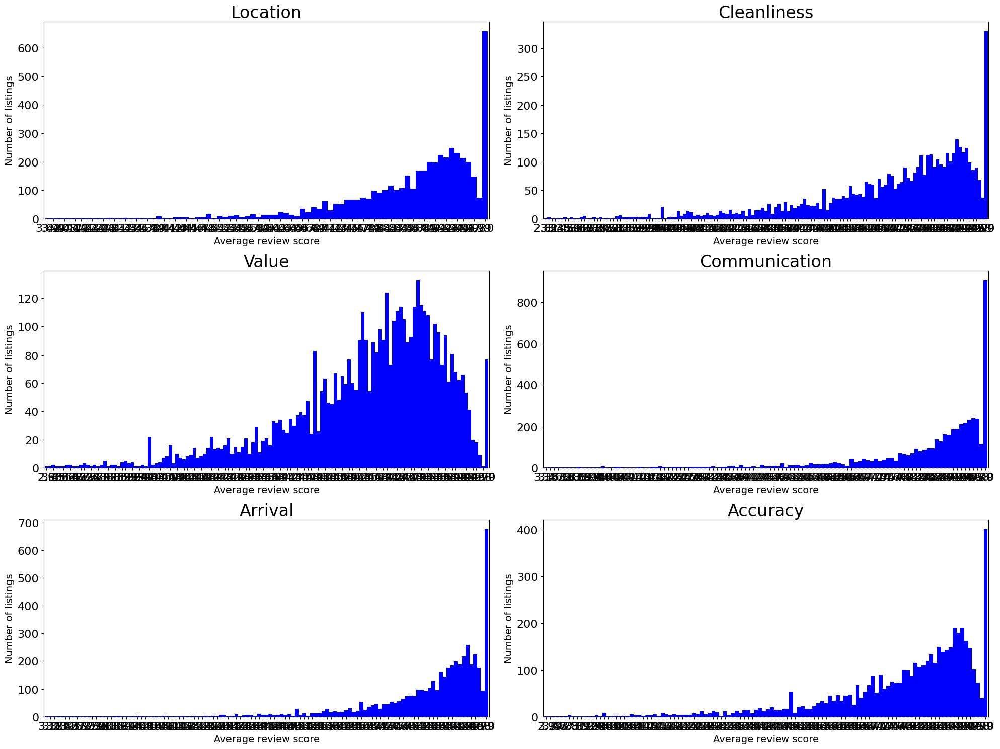

In [55]:
listings10 = filtered_listings[filtered_listings['number_of_reviews']>=10]

fig = plt.figure(figsize=(20,15))
plt.rc('xtick', labelsize=16) 
plt.rc('ytick', labelsize=16)

ax1 = fig.add_subplot(321)
feq=listings10['review_scores_location'].value_counts().sort_index() 
ax1=feq.plot.bar(color='b', width=1, rot=0)
#ax1.tick_params(axis = 'both', labelsize = 16)
plt.title("Location", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax2 = fig.add_subplot(322)
feq=listings10['review_scores_cleanliness'].value_counts().sort_index()
ax2=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Cleanliness", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax3 = fig.add_subplot(323)
feq=listings10['review_scores_value'].value_counts().sort_index()
ax3=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Value", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax4 = fig.add_subplot(324)
feq=listings10['review_scores_communication'].value_counts().sort_index()
ax4=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Communication", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax5 = fig.add_subplot(325)
feq=listings10['review_scores_checkin'].value_counts().sort_index()
ax5=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Arrival", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

ax6 = fig.add_subplot(326)
feq=listings10['review_scores_accuracy'].value_counts().sort_index()
ax6=feq.plot.bar(color='b', width=1, rot=0)
plt.title("Accuracy", fontsize=24)
plt.ylabel('Number of listings', fontsize=14)
plt.xlabel('Average review score', fontsize=14)

plt.tight_layout()
plt.show()

3. Property types

In [56]:
unique_property_types = filtered_listings.property_type.unique()
property_type_counts = filtered_listings.property_type.value_counts()

df = pd.DataFrame({'Unique Property Types': unique_property_types,'Total Count': property_type_counts})

df.head(50)


,Unique Property Types,Total Count
property_type,,
Entire rental unit,Entire rental unit,4506
Entire home,Entire home,2072
Private room in rental unit,Entire condo,483
Private room in home,Private room in rental unit,437
Entire condo,Private room in condo,210
Entire guest suite,Private room in home,203
Entire guesthouse,Private room in townhouse,168
Entire serviced apartment,Entire villa,153
Entire townhouse,Entire serviced apartment,142


4. Accomodates (Total travellers)

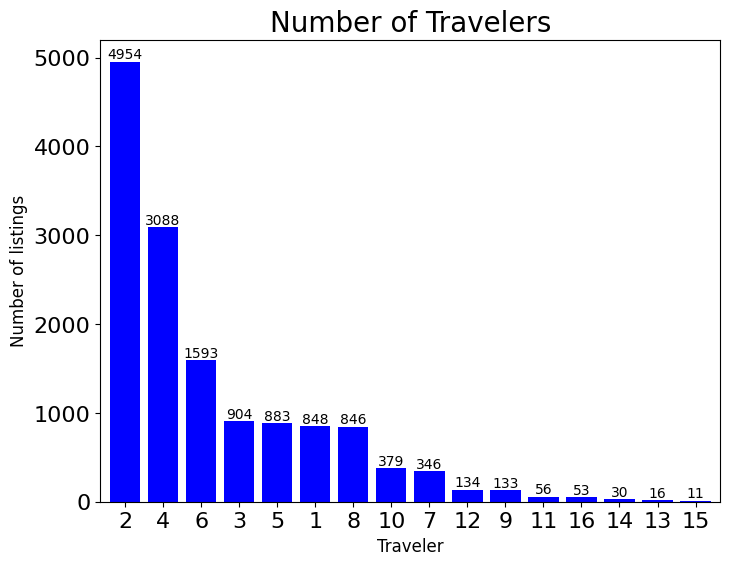

In [57]:
feq=listings['accommodates'].value_counts().sort_values(ascending=False)
feq.plot.bar(figsize=(8, 6), color='b', width=0.8, rot=0)
plt.title("Number of Travelers", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Traveler', fontsize=12)
for index, value in enumerate(feq):
    plt.text(index, value, str(value), ha='center', va='bottom')

plt.show()

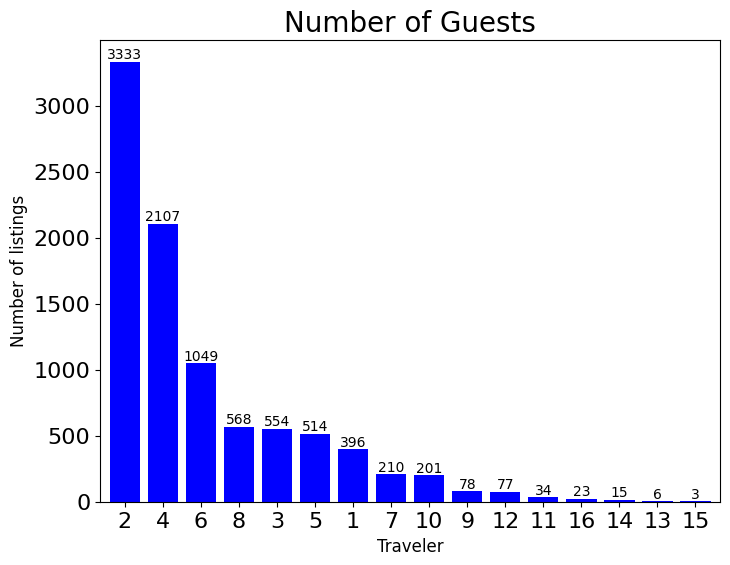

In [58]:
#Number of Travelers in the top 10 Neighbourhoods
ten=filtered_listings['accommodates'].value_counts().sort_values(ascending=False)
ten.plot.bar(figsize=(8, 6), color='b', width=0.8, rot=0)
plt.title("Number of Guests", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Traveler', fontsize=12)
for index, value in enumerate(ten):
    plt.text(index, value, str(value), ha='center', va='bottom')

plt.show()

In [59]:
total_guests = filtered_listings['accommodates'].sum()
print("Total guests accommodated in the top 10 neighbourhoods:", total_guests)


Total guests accommodated in the top 10 neighbourhoods: 36741


*The Amount of Travelers over Time*

In [60]:
# Convert 'date' in 'calendar' to datetime type
calendar['date'] = pd.to_datetime(calendar['date'])

# If 'calendar' uses 'listing_id' to reference listings, adjust the merge accordingly
# This assumes 'listings' uses 'id' as its identifier and 'calendar' references this via 'listing_id'
merged_data = pd.merge(listings, calendar, left_on='id', right_on='listing_id', how='left')
merged_data.head()



,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price_x,minimum_nights_x,number_of_reviews,...,availability_90,maximum_nights_x,listing_url,neighborhood_overview,date,available,price_y,adjusted_price,minimum_nights_y,maximum_nights_y
0,Self service English breakfast,211218678,Paul,Botany Bay,-33.92406,151.19732,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,2024-03-18,f,$100.00,NaN,1,365
1,Self service English breakfast,211218678,Paul,Botany Bay,-33.92406,151.19732,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,2024-03-19,t,$100.00,NaN,1,365
2,Self service English breakfast,211218678,Paul,Botany Bay,-33.92406,151.19732,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,2024-03-20,t,$100.00,NaN,1,365
3,Self service English breakfast,211218678,Paul,Botany Bay,-33.92406,151.19732,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,2024-03-21,t,$100.00,NaN,1,365
4,Self service English breakfast,211218678,Paul,Botany Bay,-33.92406,151.19732,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,2024-03-22,t,$100.00,NaN,1,365


In [61]:
calendar.columns


Index(['date', 'available', 'price', 'adjusted_price', 'minimum_nights',
       'maximum_nights'],
      dtype='object')

In [62]:
calendar.head()

,date,available,price,adjusted_price,minimum_nights,maximum_nights
listing_id,,,,,,
11156,2024-03-18,f,$65.00,NaN,90,180
11156,2024-03-19,t,$65.00,NaN,90,180
11156,2024-03-20,t,$65.00,NaN,90,180
11156,2024-03-21,t,$65.00,NaN,90,180
11156,2024-03-22,t,$65.00,NaN,90,180


In [63]:
# Filter the data for unavailable listings (availability == 'f')
unavailable_listings = merged_data[merged_data['available'] == 'f']

# Group by 'date', 'room_type', and 'name', then count the unique names
grouped = unavailable_listings.groupby(['date', 'room_type'])['name'].nunique().reset_index(name='unique_names_count')

# Pivot the data to get a daily summary by room type with unique names count
daily_availability = grouped.pivot(index='date', columns='room_type', values='unique_names_count')

# Fill missing values with 0 (if any)
daily_availability.fillna(0, inplace=True)

# Display the daily availability table
print(daily_availability)


room_type   Entire home/apt  Hotel room  Private room  Shared room
date                                                              
2024-03-16             1000          28           327           22
2024-03-17              829           8           232           14
2024-03-18             9195          44          1913           52
2024-03-19             8064          39          1558           34
2024-03-20             7868          36          1467           32
...                     ...         ...           ...          ...
2025-03-13             7433          27          1623           54
2025-03-14             7431          27          1625           56
2025-03-15             7427          28          1624           56
2025-03-16             6698          19          1396           38
2025-03-17             6704          19          1397           38

[367 rows x 4 columns]


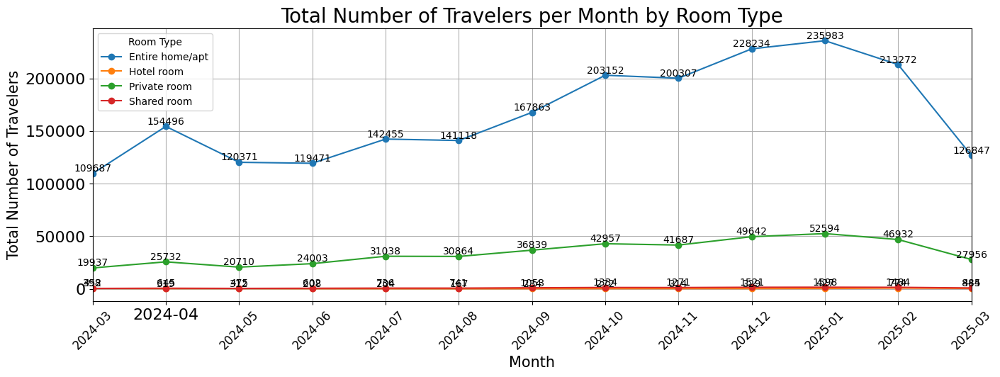

In [64]:
# Convert 'date' in 'calendar' to datetime type
calendar['date'] = pd.to_datetime(calendar['date'])

# If 'calendar' uses 'listing_id' to reference listings, adjust the merge accordingly
# This assumes 'listings' uses 'id' as its identifier and 'calendar' references this via 'listing_id'
merged_data = pd.merge(listings, calendar, left_on='id', right_on='listing_id', how='left')

# Group by 'room_type' and 'date' (resampled monthly), then count the available listings on each day
grouped = merged_data.groupby(['room_type', pd.Grouper(key='date', freq='M')])['available'].apply(lambda x: x.eq('f').sum()).reset_index()

# Pivot the data for plotting
pivot = grouped.pivot(index='date', columns='room_type', values='available')


# Adjusting the figure size and creating a plot with markers for each data point
fig, ax = plt.subplots(figsize=(16, 5))
pivot.plot(ax=ax, marker='o', linestyle='-')

# Adding a plot title and customizing its font size
plt.title("Total Number of Travelers per Month by Room Type", fontsize=20)

# Adding axis labels and customizing their font size
plt.xlabel("Month", fontsize=15)
plt.ylabel("Total Number of Travelers", fontsize=15)

# Rotating axis ticks and customizing their font size
plt.xticks(rotation=45, fontsize=12)  # Adjusted for better fit

# Adjusting x-tick labels to show month names or month-year
xtick_labels = [x.strftime('%Y-%m') for x in pivot.index]
ax.set_xticks(pivot.index)  # Set the ticks first
ax.set_xticklabels(xtick_labels)  # Then set the labels

# Annotate each marker with its total. Annotations adjusted for clarity.
for column in pivot.columns:
    for date, value in pivot[column].dropna().items():  # Use items() instead of iteritems()
        ax.text(date, value, f'{int(value)}', color='black', ha='center', va='bottom')

plt.legend(title='Room Type')
plt.grid(True)
plt.show()

TOP 10 Neighborhoods

In [65]:
# Convert 'date' in 'calendar' to datetime type
calendar['date'] = pd.to_datetime(calendar['date'])

# If 'calendar' uses 'listing_id' to reference listings, adjust the merge accordingly
# This assumes 'listings' uses 'id' as its identifier and 'calendar' references this via 'listing_id'
merged_fdata = pd.merge(filtered_listings, calendar, left_on='id', right_on='listing_id', how='left')
merged_fdata.head()

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price_x,minimum_nights_x,number_of_reviews,...,availability_90,maximum_nights_x,listing_url,neighborhood_overview,date,available,price_y,adjusted_price,minimum_nights_y,maximum_nights_y
0,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.87483,151.2258,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,2024-03-18,f,$250.00,NaN,1,365
1,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.87483,151.2258,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,2024-03-19,f,$250.00,NaN,1,365
2,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.87483,151.2258,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,2024-03-20,f,$250.00,NaN,1,365
3,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.87483,151.2258,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,2024-03-21,f,$250.00,NaN,1,365
4,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.87483,151.2258,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,2024-03-22,f,$250.00,NaN,1,365


**TOP 10 Hosts in Sydney**

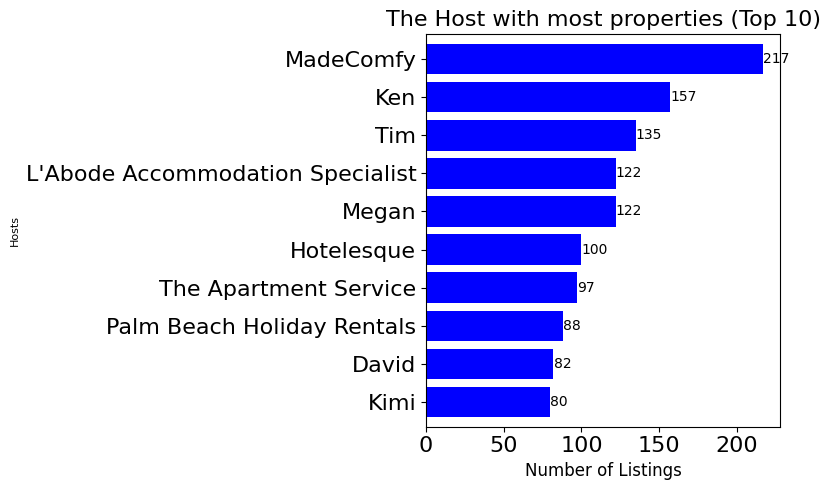

In [66]:
feq = listings['host_name'].value_counts().sort_values(ascending=True)
top_10_feq = feq.tail(10)  
total_listings_by_neighborhood = listings.groupby('host_name')['name'].count() 

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8)

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    host_name = top_10_feq.index[i]  
    total_listings = total_listings_by_neighborhood.loc[host_name]
    ax.text(v + 0.1, i, f"{total_listings:,.0f}", va='center')  # Display total listings

plt.title("The Host with most properties (Top 10)", fontsize=16)
plt.xlabel('Number of Listings', fontsize=12)
plt.ylabel('Hosts', fontsize=8)
plt.tight_layout()
plt.show()

**The most beloved Host based on rating**

In [67]:
Listings_review_data = pd.merge(listings, reviews_details, left_on='id', right_on='listing_id', how='left')
Listings_review_data.head()

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,...,availability_90,maximum_nights,listing_url,neighborhood_overview,listing_id,id,date,reviewer_id,reviewer_name,comments
0,Self service English breakfast,211218678,Paul,Botany Bay,-33.924060,151.197320,Private room,100.0,1,0,...,89,365,https://www.airbnb.com/rooms/1050164598350388320,NaN,NaN,NaN,NaT,NaN,NaN,NaN
1,Apartment in Rushcutters Bay,26721338,Anne,Sydney,-33.874830,151.225800,Entire home/apt,250.0,1,0,...,48,365,https://www.airbnb.com/rooms/1096082243192434668,NaN,NaN,NaN,NaT,NaN,NaN,NaN
2,"Modern Sydney home near beach,shops",11059668,Sophie,Waverley,-33.895820,151.245490,Entire home/apt,650.0,90,1,...,90,1125,https://www.airbnb.com/rooms/2167538,Queens Park is a safe and friendly neighbourho...,2.167538e+06,2.892986e+07,2015-04-01,24777736.0,Taylor,"My host was incredibly welcoming, leaving a bo..."
3,Luxury double room,202112801,Vivian,Canada Bay,-33.851626,151.086324,Private room,84.0,1,31,...,90,365,https://www.airbnb.com/rooms/790607305500629830,NaN,7.906073e+17,7.988608e+17,2023-01-07,56754166.0,Peipei,Nice place and very clean and tidy. The host i...
4,Luxury double room,202112801,Vivian,Canada Bay,-33.851626,151.086324,Private room,84.0,1,31,...,90,365,https://www.airbnb.com/rooms/790607305500629830,NaN,7.906073e+17,8.097355e+17,2023-01-22,208533375.0,Danielle,Good location for a short stay. Clean and safe...


In [68]:
Listings_review_data.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license', 'neighbourhood_cleansed',
       'property_type', 'host_picture_url', 'maximum_minimum_nights',
       'host_since', 'last_scraped', 'maximum_maximum_nights',
       'calculated_host_listings_count_private_rooms', 'availability_60',
       'host_is_superhost', 'amenities', 'host_response_time',
       'review_scores_value', 'review_scores_checkin', 'availability_30',
       'review_scores_accuracy', 'host_listings_count',
       'neighbourhood_group_cleansed', 'host_total_listings_count',
       'maximum_nights_avg_ntm', 'instant_bookable', 'first_review',
       'minimum_minimum_nights', 'calculated_host_listings_count_shared_rooms',
       'calendar_last_scraped', 'review_scores_rating', 'has_

In [69]:
""" 
df = pd.DataFrame(Listings_review_data)

# Group by 'host_name' and 'room_type', then count the number of occurrences
room_counts = df.groupby('host_name').size().unstack(fill_value=0)

# If any of the specific room types are missing in your dataset, ensure they are included with a default count of 0
for room_type in ['Entire home/apt', 'Private room', 'Shared room', 'Hotel room']:
    if room_type not in room_counts.columns:
        room_counts[room_type] = 0

# Calculate the total properties for each host
room_counts['Total Properties'] = room_counts.sum(axis=1)

# Sort the DataFrame by 'Total Properties' in descending order to see the hosts with the most properties first
sorted_room_counts = room_counts.sort_values(by='Total Properties', ascending=False)

# Display the sorted DataFrame to verify the results
print(sorted_room_counts.head(10)) """




" \ndf = pd.DataFrame(Listings_review_data)\n\n# Group by 'host_name' and 'room_type', then count the number of occurrences\nroom_counts = df.groupby('host_name').size().unstack(fill_value=0)\n\n# If any of the specific room types are missing in your dataset, ensure they are included with a default count of 0\nfor room_type in ['Entire home/apt', 'Private room', 'Shared room', 'Hotel room']:\n    if room_type not in room_counts.columns:\n        room_counts[room_type] = 0\n\n# Calculate the total properties for each host\nroom_counts['Total Properties'] = room_counts.sum(axis=1)\n\n# Sort the DataFrame by 'Total Properties' in descending order to see the hosts with the most properties first\nsorted_room_counts = room_counts.sort_values(by='Total Properties', ascending=False)\n\n# Display the sorted DataFrame to verify the results\nprint(sorted_room_counts.head(10)) "

**The host with the most reviews**

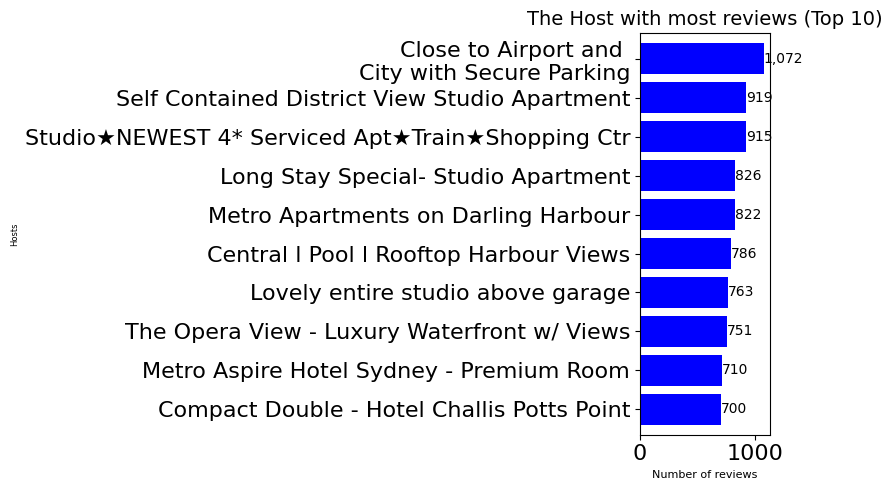

In [70]:
feq = Listings_review_data['name'].value_counts().sort_values(ascending=True)
top_10_feq = feq.tail(10)  
total_listings_by_host= Listings_review_data.groupby('name')['reviews_per_month'].count() 

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8)

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    host_name = top_10_feq.index[i]  
    total_listings = total_listings_by_host.loc[host_name]
    ax.text(v + 0.1, i, f"{total_listings:,.0f}", va='center')  # Display total listings

plt.title("The Host with most reviews (Top 10)", fontsize=14)
plt.xlabel('Number of reviews', fontsize=8)
plt.ylabel('Hosts', fontsize=6)
plt.tight_layout()
plt.show()

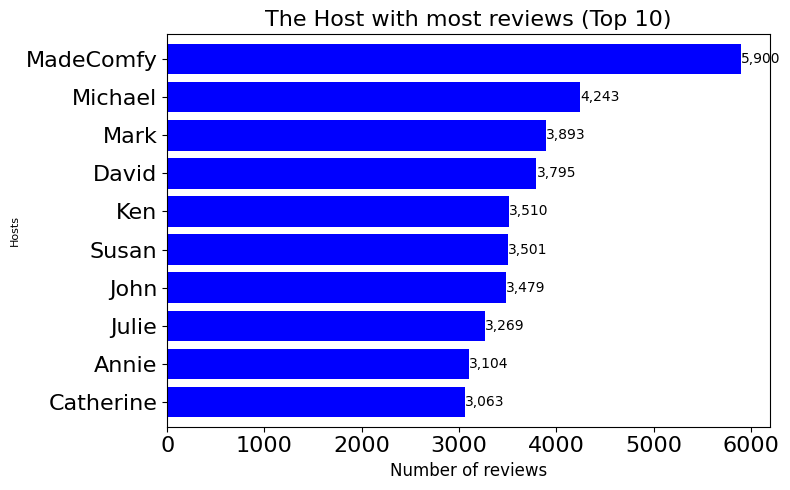

In [71]:
feq = Listings_review_data['host_name'].value_counts().sort_values(ascending=True)
top_10_feq = feq.tail(10)  
total_listings_by_host= Listings_review_data.groupby('host_name')['number_of_reviews'].count() 

fig, ax = plt.subplots(figsize=(8, 5))

top_10_feq.plot.barh(ax=ax, color='b', width=0.8)

# Add labels to the right of the bars
for i, v in enumerate(top_10_feq):
    host_name = top_10_feq.index[i]  
    total_listings = total_listings_by_host.loc[host_name]
    ax.text(v + 0.1, i, f"{total_listings:,.0f}", va='center')  # Display total listings

plt.title("The Host with most reviews (Top 10)", fontsize=16)
plt.xlabel('Number of reviews', fontsize=12)
plt.ylabel('Hosts', fontsize=8)
plt.tight_layout()
plt.show()

The top 10 host with the best review

In [72]:
Listings_review_data.number_of_reviews.count()

501961

In [73]:
df_grouped = df.groupby('host_name').agg({
    'review_scores_rating': 'mean', 
    'number_of_reviews': 'sum'
}).reset_index()

def normalize_to_scale(column, scale_min, scale_max):
    """
    Normalize a pandas Series column to a new scale.
    
    Parameters:
    - column: Pandas Series to normalize.
    - scale_min: The minimum value of the new scale.
    - scale_max: The maximum value of the new scale.
    
    Returns:
    - Pandas Series with values normalized to the new scale.
    """
    # Find the minimum and maximum of the original column
    original_min = column.min()
    original_max = column.max()
    
    # Normalize column to the 0-5 scale
    normalized = (column - original_min) / (original_max - original_min) * (scale_max - scale_min) + scale_min
    
    return normalized

# Assuming df_grouped is your DataFrame with aggregated values
# Normalize review_scores_rating to a 0-5 scale (if needed)
df_grouped['normalized_review_scores'] = normalize_to_scale(df_grouped['review_scores_rating'], 0, 5)

# Proceed with your sorting and selection
df_sorted = df_grouped.sort_values(by='normalized_review_scores', ascending=False)
df_sorted.head(10)


KeyError: 'host_name'

In [ ]:
# Sort the DataFrame by 'review_scores_rating' in descending order
df_sortedNum = df_grouped.sort_values(by='number_of_reviews', ascending=False)

# Now df_sorted will have unique hosts, sorted by their average review_scores_rating
df_sortedNum.head(10)

,host_name,review_scores_rating,number_of_reviews,normalized_review_scores
2834,Susan,4.765858,1931638,4.581335
335,Beverley And Michael,4.890000,1149184,4.732360
2793,Steve,4.825053,1021049,4.653349
3075,Victoria,4.875376,941615,4.714569
3196,Yimu,4.647495,854386,4.437342
596,Craig,4.891629,805562,4.734342
2985,Tommy,4.872670,781259,4.711277
1397,John,4.788889,721376,4.609354
2007,Michael,4.844071,715587,4.676485
2001,Metro Hotels,4.416488,687565,4.156311


In [ ]:
#calculate the total score and place it in range 0-5. This range need to be exact considering the amount of preminilary score for each number

df_grouped['Score'] = df_grouped['normalized_review_scores'] * df_grouped['number_of_reviews']

max_score = df_grouped['Score'].max()
min_score = df_grouped['Score'].min()

# Applying the normalization formula to scale scores from 0 to 5
df_grouped['Normalized_Score'] = (df_grouped['Score'] - min_score) / (max_score - min_score) * 5

# Sort the DataFrame by 'Normalized_Score' in descending order
df_sorted_by_score = df_grouped.sort_values(by='Normalized_Score', ascending=False)

# Display the top 10 entries after sorting
top_10_sorted_by_score = df_sorted_by_score.head(10)
top_10_sorted_by_score.head(10)


,host_name,review_scores_rating,number_of_reviews,normalized_review_scores,Score,Normalized_Score
2834,Susan,4.765858,1931638,4.581335,8.849481e+06,5.000000
335,Beverley And Michael,4.890000,1149184,4.732360,5.438353e+06,3.072696
2793,Steve,4.825053,1021049,4.653349,4.751297e+06,2.684506
3075,Victoria,4.875376,941615,4.714569,4.439309e+06,2.508231
596,Craig,4.891629,805562,4.734342,3.813806e+06,2.154819
3196,Yimu,4.647495,854386,4.437342,3.791203e+06,2.142048
2985,Tommy,4.872670,781259,4.711277,3.680728e+06,2.079629
2007,Michael,4.844071,715587,4.676485,3.346432e+06,1.890750
1397,John,4.788889,721376,4.609354,3.325077e+06,1.878685
1010,Getawayz,4.794865,675172,4.616624,3.117015e+06,1.761129


5. Finding possibly illegal hotels

- Illegal Entire home/apt

In [ ]:
entire = listings[listings['room_type'] == "Entire home/apt"]
entire_home = entire.groupby(['host_id', 'host_name', 'host_location']).size().reset_index(name='Entire home/apt').sort_values(by=['Entire home/apt'], ascending=False)
#entire_home = entire.groupby(['host_id', 'host_name', 'property_type', 'host_location']).size().reset_index(name='Entire home/apt').sort_values(by=['Entire home/apt'], ascending=False)
entire_home

,host_id,host_name,host_location,Entire home/apt
3936,279001183,MadeComfy,"Sydney, Australia",217
683,7409213,L'Abode Accommodation Specialist,"Sydney, Australia",122
241,2450066,Hotelesque,"Sydney, Australia",100
1159,15739069,The Apartment Service,"Sydney, Australia",97
3987,301753450,Tim,"Sydney, Australia",89
...,...,...,...,...
1620,27799308,Ana,"Coogee, Australia",1
1621,27923354,Nicolette,"Sydney, Australia",1
1622,27926711,Kate,"Sydney, Australia",1
1623,27926990,Anita,"New South Wales, Australia",1


In [ ]:
entire_home = entire.groupby(['host_id', 'host_name', 'property_type', 'host_location']).size().reset_index(name='Entire home/apt').sort_values(by=['Entire home/apt'], ascending=False)
entire_home

,host_id,host_name,property_type,host_location,Entire home/apt
4297,279001183,MadeComfy,Entire rental unit,"Sydney, Australia",174
1591,23717928,Palm Beach Holiday Rentals,Entire home,"Palm Beach, Australia",86
1266,15739069,The Apartment Service,Entire rental unit,"Sydney, Australia",86
265,2450066,Hotelesque,Entire rental unit,"Sydney, Australia",85
743,7409213,L'Abode Accommodation Specialist,Entire rental unit,"Sydney, Australia",79
...,...,...,...,...,...
1746,27137765,Daniela,Entire home,"North Balgowlah, Australia",1
1745,27126149,Julie,Entire rental unit,Australia,1
1744,27086431,Colleen,Entire home,"North Willoughby, Australia",1
1743,27076366,Paul,Entire home,"Lane Cove West, Australia",1


In [ ]:
entire.property_type.unique()

array(['Entire rental unit', 'Entire home', 'Entire condo',
       'Entire cottage', 'Entire villa', 'Entire serviced apartment',
       'Entire guest suite', 'Entire guesthouse', 'Entire townhouse',
       'Entire loft', 'Farm stay', 'Entire vacation home', 'Entire cabin',
       'Entire place', 'Room in aparthotel', 'Entire bungalow',
       'Entire home/apt', 'Dome', 'Barn', 'Holiday park', 'Camper/RV',
       'Treehouse', 'Tiny home', 'Boat', 'Casa particular', 'Island',
       'Tent', 'Campsite', 'Houseboat', 'Earthen home', 'Train'],
      dtype=object)

In [ ]:
tim = entire[entire['host_id']== 301753450]
tim = tim[['name','host_id', 'host_name', 'property_type', 'latitude', 'longitude']]
tim.index.name = "listing_id"

,name,host_id,host_name,property_type,latitude,longitude
listing_id,,,,,,
558020110075428590,Spacious 2BR Apartment with Stunning Waterview,301753450,Tim,Entire rental unit,-33.827630,151.086230
665588406920538209,Immerse yourself in the true waterfront life s...,301753450,Tim,Entire rental unit,-33.827070,151.084560
986572199837161649,Peaceful home Wentworth Point/Sydney Olympic Park,301753450,Tim,Entire rental unit,-33.829957,151.072864
46321809,Relax Enjoy Waterfront Lifestyle Near Olympic ...,301753450,Tim,Entire rental unit,-33.827350,151.076340
669844171685518681,Waterfront NEW 2BR on top of Marina Square Cen...,301753450,Tim,Entire rental unit,-33.823580,151.078680
...,...,...,...,...,...,...
54280265,"Cozy 2 bedroom unit, prime location. Pet friendly",301753450,Tim,Entire rental unit,-33.885220,151.177870
39368023,Spacious & Quiet 1 Bedroom Apt on high floor,301753450,Tim,Entire rental unit,-33.826270,151.076840
745253750397532828,Convenient High Floor Home Lookout to CBD & Park,301753450,Tim,Entire serviced apartment,-33.904780,151.212740


In [ ]:
tim.property_type.unique()

array(['Entire rental unit', 'Entire serviced apartment', 'Entire home',
       'Entire condo'], dtype=object)

In [ ]:
lats = tim['latitude'].tolist()
lons = tim['longitude'].tolist()
locations = list(zip(lats, lons))

map1 = folium.Map(location=[-33.90568, 151.2093], zoom_start=11.5)
FastMarkerCluster(data=locations).add_to(map1)
map1

- Illegal Private room

In [ ]:
private = listings[listings['room_type'] == "Private room"]
host_private = private.groupby(['host_id', 'host_name', 'host_location']).size().reset_index(name='private_rooms').sort_values(by=['private_rooms'], ascending=False)
host_private

,host_id,host_name,host_location,private_rooms
1065,288743418,Ken,"Padstow, Australia",118
1238,550751733,Red Ant,"Padstow, Australia",31
1237,548634954,JLC Stayz,"Sydney, Australia",28
949,202112801,Vivian,Australia,25
1144,381393416,Polly,"Sydney, Australia",19
...,...,...,...,...
466,47608979,Libby,"Warriewood, Australia",1
467,47661145,Nat,"Westmead, Australia",1
470,48115618,Giovanni,"New South Wales, Australia",1
471,48282003,Karen,"Sydney, Australia",1


#proofing the legality by searching for gps for Ken

In [ ]:
ken = private[private['host_id']== 288743418]
ken = ken[['name','host_id', 'host_name','property_type', 'latitude', 'longitude']]
ken.index.name = "listing_id"
ken

,name,host_id,host_name,property_type,latitude,longitude
listing_id,,,,,,
1075744770774827053,Sydney CBD Near Train UTS DarlingHar&ICC&China...,288743418,Ken,Private room in home,-33.883010,151.209000
49469838,Studio near Bus Train UTS DaringHar ICC Chinatown,288743418,Ken,Private room in home,-33.884900,151.209640
41625696,Sydney CBD Near Train UTS DarlingHar&ICC&China...,288743418,Ken,Private room in home,-33.884930,151.209330
46092204,Boutique Private Rm situated in the heart of B...,288743418,Ken,Private room in home,-33.871990,151.109930
1008411169438238730,Double Room in Gordon near Train & Bus,288743418,Ken,Private room in home,-33.755350,151.149630
...,...,...,...,...,...,...
1074107057498725215,Private Room in Gordon near Train & Bus - Slee...,288743418,Ken,Private room in home,-33.752880,151.148520
1008409739864171928,Queen Room in Gordon near Train & Bus,288743418,Ken,Private room in home,-33.753392,151.148309
1008410582965539650,Queen Room in Gordon near Train & Bus,288743418,Ken,Private room in home,-33.753324,151.149641


In [ ]:
ken.property_type.unique()

array(['Private room in home', 'Private room in rental unit'],
      dtype=object)

In [ ]:
lats = ken['latitude'].tolist()
lons = ken['longitude'].tolist()
locations = list(zip(lats, lons))

map1 = folium.Map(location=[-33.90568, 151.2093], zoom_start=11.5)
FastMarkerCluster(data=locations).add_to(map1)
map1

In [ ]:
#need further information
freq = listings.groupby(['host_id']).size().reset_index(name='num_host_listings')
host_prop = freq.groupby(['num_host_listings']).size().reset_index(name='count').transpose()
host_prop.columns = host_prop.iloc[0]
host_prop = host_prop.drop(host_prop.index[0])
host_prop

num_host_listings,1,2,3,4,5,6,7,8,9,10,...,58,62,80,88,89,97,100,122,134,217
count,6356,778,239,113,59,51,35,27,20,17,...,1,1,1,1,1,1,1,1,1,1


In [ ]:
freq = listings.groupby(['host_id', 'host_name', 'host_about']).size().reset_index(name='num_host_listings')
freq = freq.sort_values(by=['num_host_listings'], ascending=False)
freq = freq[freq['num_host_listings'] >= 20]
freq

,host_id,host_name,host_about,num_host_listings
3388,279001183,MadeComfy,"Hi, and welcome to MadeComfy!\n\nWe are a team...",217
3401,288743418,Ken,"Father of 4, I love real estate and accommodat...",134
781,7409213,L'Abode Accommodation Specialist,L'Abode Accommodation specialises in short and...,122
279,2450066,Hotelesque,Hotelesque provides premium short and long ter...,100
1250,15739069,The Apartment Service,Hi there! We are a professional Property Manag...,97
3419,301753450,Tim,"Hello,\n\nThis is Tim from AirPillows, and I a...",89
1538,23717928,Palm Beach Holiday Rentals,For those guests who demand flawless accommoda...,88
2597,91961414,Kimi,I look forward to being your host here in sydn...,80
2660,101139031,Gabriel HH,I work closely with Airbnb and know what it ta...,58
344,3046924,Contemporary Hotels,Contemporary Hotels is Australia's leading ind...,56


**Tourits Tips**

*Average daily price per neighbourhood*

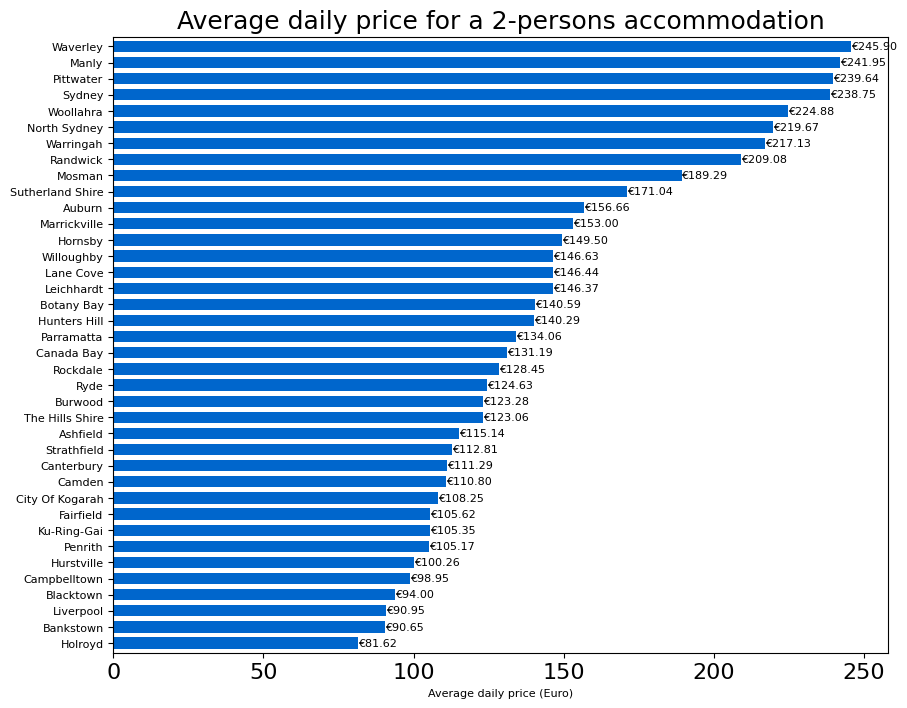

In [ ]:
feq = listings[listings['accommodates']==2]
feq = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
feq.plot.barh(figsize=(10, 8), color='#0066CC', width=0.7)
plt.title("Average daily price for a 2-persons accommodation", fontsize=18)
plt.xlabel('Average daily price (Euro)', fontsize=8)
plt.ylabel("")
plt.tick_params(axis='y', labelsize=8) 
for index, value in enumerate(feq):
    plt.text(value, index, f"€{value:.2f}", va='center', color='black', fontsize=8)

plt.show()

In [ ]:
adam = gpd.read_file(r"C:\Users\prisi\Documents\2021\UNI\ws23\IU\Data Analytics and Big Data\Sydney, New South Wales, Australia - Airbnb\neighbourhoods.geojson")
feq = pd.DataFrame([feq])
feq = feq.transpose()
adam = pd.merge(adam, feq, on='neighbourhood', how='left')
adam.rename(columns={'price': 'average_price'}, inplace=True)
adam.average_price = adam.average_price.round(decimals=0)

map_dict = adam.set_index('neighbourhood')['average_price'].to_dict()
color_scale = LinearColormap(['yellow','red'], vmin = min(map_dict.values()), vmax = max(map_dict.values()))

def get_color(feature):
    value = map_dict.get(feature['properties']['neighbourhood'])
    return color_scale(value)

map3 = folium.Map(location=[-33.90568, 151.2093], zoom_start=11)
folium.GeoJson(data=adam,
               name='Amsterdam',
               tooltip=folium.features.GeoJsonTooltip(fields=['neighbourhood', 'average_price'],
                                                      labels=True,
                                                      sticky=True),
               style_function= lambda feature: {
                   'fillColor': get_color(feature),
                   'color': 'black',
                   'weight': 1,
                   'dashArray': '5, 5',
                   'fillOpacity':0.5
                   },
               highlight_function=lambda feature: {'weight':3, 'fillColor': get_color(feature), 'fillOpacity': 0.8}).add_to(map3)
map3

with this heat map we can see that the majority of the neighbourhoods has the average price range 100-150$ and the most expensive neighbourhood is Waverly with the average price around $246

*Review scores location, and location scores versus price*

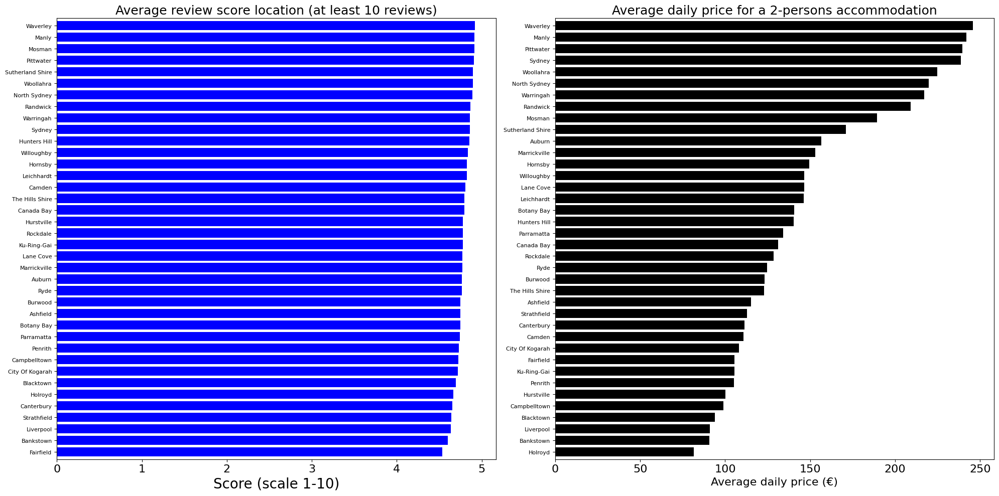

In [ ]:
fig = plt.figure(figsize=(20,10))
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=20)

ax1 = fig.add_subplot(121)
feq = listings[listings['number_of_reviews']>=10]
feq1 = feq.groupby('neighbourhood')['review_scores_location'].mean().sort_values(ascending=True)
ax1=feq1.plot.barh(color='b', width=0.8)
plt.title("Average review score location (at least 10 reviews)", fontsize=18)
plt.xlabel('Score (scale 1-10)', fontsize=20)
plt.tick_params(axis='y', labelsize=8) 
plt.ylabel("")

ax2 = fig.add_subplot(122)
feq = listings[listings['accommodates']==2]
feq2 = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
ax2=feq2.plot.barh(color='black', width=0.8)
plt.title("Average daily price for a 2-persons accommodation", fontsize=18)
plt.xlabel('Average daily price (€)', fontsize=16)
plt.ylabel("")
plt.tick_params(axis='y', labelsize=8) 
plt.tight_layout()
plt.show()

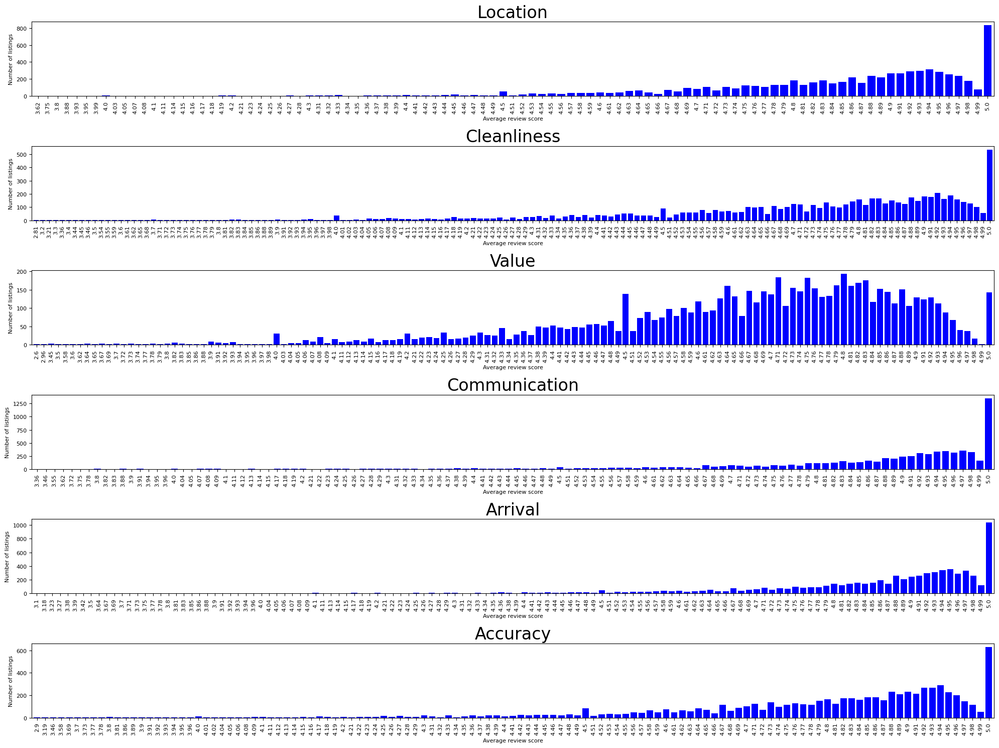

In [ ]:
listings10 = listings[listings['number_of_reviews']>=10]

fig = plt.figure(figsize=(20,15))
plt.rc('xtick', labelsize=8) 
plt.rc('ytick', labelsize=8)

ax1 = fig.add_subplot(611)
feq=listings10['review_scores_location'].value_counts().sort_index()
ax1=feq.plot.bar(color='b', width=0.8, rot=0)
#ax1.tick_params(axis = 'both', labelsize = 16)
plt.title("Location", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

ax2 = fig.add_subplot(612)
feq=listings10['review_scores_cleanliness'].value_counts().sort_index()
ax2=feq.plot.bar(color='b', width=0.8, rot=0)
plt.title("Cleanliness", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

ax3 = fig.add_subplot(613)
feq=listings10['review_scores_value'].value_counts().sort_index()
ax3=feq.plot.bar(color='b', width=0.8, rot=0)
plt.title("Value", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

ax4 = fig.add_subplot(614)
feq=listings10['review_scores_communication'].value_counts().sort_index()
ax4=feq.plot.bar(color='b', width=0.8, rot=0)
plt.title("Communication", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

ax5 = fig.add_subplot(615)
feq=listings10['review_scores_checkin'].value_counts().sort_index()
ax5=feq.plot.bar(color='b', width=0.8, rot=0)
plt.title("Arrival", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

ax6 = fig.add_subplot(616)
feq=listings10['review_scores_accuracy'].value_counts().sort_index()
ax6=feq.plot.bar(color='b', width=0.8, rot=0)
plt.title("Accuracy", fontsize=24)
plt.ylabel('Number of listings', fontsize=8)
plt.xlabel('Average review score', fontsize=8)
plt.tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()

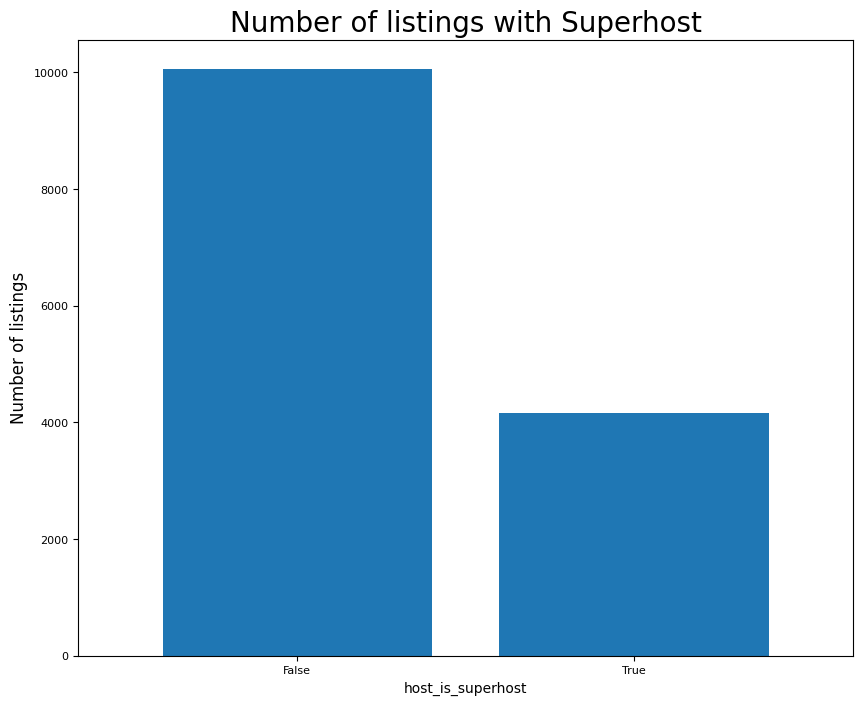

In [ ]:
listings.host_is_superhost = listings.host_is_superhost.replace({"t": "True", "f": "False"})

feq=listings['host_is_superhost'].value_counts()
feq.plot.bar(figsize=(10, 8), width=0.8, rot=0)
plt.title("Number of listings with Superhost", fontsize=20)
plt.ylabel('Number of listings', fontsize=12)

plt.show()

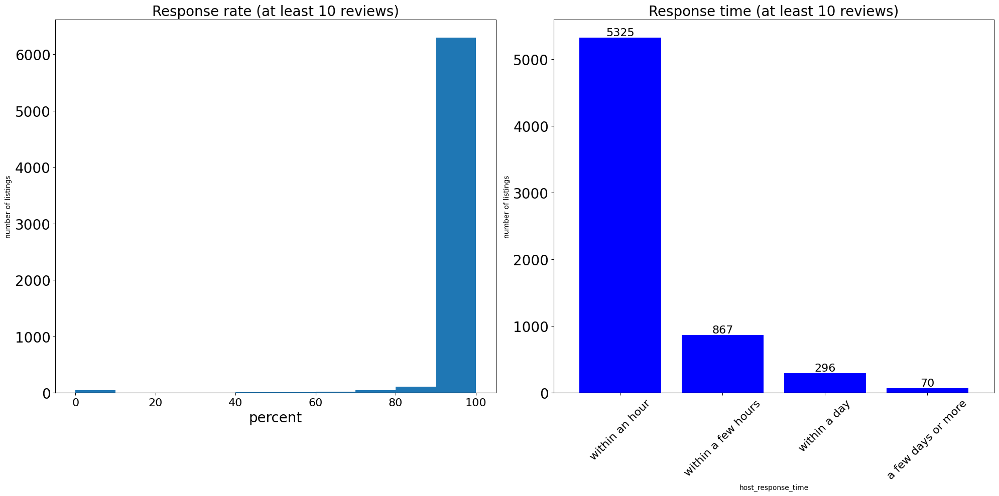

In [ ]:
fig = plt.figure(figsize=(20,10))
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=20)

ax1 = fig.add_subplot(121)
feq1 = listings10['host_response_rate'].dropna()
ax1= plt.hist(feq1)
plt.title("Response rate (at least 10 reviews)", fontsize=20)
plt.ylabel("number of listings")
plt.xlabel("percent", fontsize=20)


ax2 = fig.add_subplot(122)
feq2 = listings10['host_response_time'].value_counts()
ax2=feq2.plot.bar(color='b', width=0.8, rot=45)
plt.title("Response time (at least 10 reviews)", fontsize=20)
plt.ylabel("number of listings")
for index, value in enumerate(feq2):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=16)

plt.tight_layout()
plt.show()

Availability over time

In [74]:
print("Calendar shapes and columns:")
print(calendar.columns)
print(calendar.shape)
calendar.head()


Calendar shapes and columns:
Index(['date', 'available', 'price', 'adjusted_price', 'minimum_nights',
       'maximum_nights'],
      dtype='object')
(5210010, 6)


,date,available,price,adjusted_price,minimum_nights,maximum_nights
listing_id,,,,,,
11156,2024-03-18,f,$65.00,NaN,90,180
11156,2024-03-19,t,$65.00,NaN,90,180
11156,2024-03-20,t,$65.00,NaN,90,180
11156,2024-03-21,t,$65.00,NaN,90,180
11156,2024-03-22,t,$65.00,NaN,90,180


In [75]:
calendar.price = calendar.price.str.replace(",","")
calendar['price'] = pd.to_numeric(calendar['price'].str.strip('$'))
#calendar = calendar[calendar.date < '2019-12-05']
calendar.head()

,date,available,price,adjusted_price,minimum_nights,maximum_nights
listing_id,,,,,,
11156,2024-03-18,f,65.0,NaN,90,180
11156,2024-03-19,t,65.0,NaN,90,180
11156,2024-03-20,t,65.0,NaN,90,180
11156,2024-03-21,t,65.0,NaN,90,180
11156,2024-03-22,t,65.0,NaN,90,180


In [76]:
listings.index.name = "listing_id"
calendar = pd.merge(calendar, listings[['accommodates']], on = "listing_id", how = "left")
sample_output = calendar.sample(15)
sample_output

,date,available,price,adjusted_price,minimum_nights,maximum_nights,accommodates
listing_id,,,,,,,
48551665,2024-04-20,f,399.0,NaN,1,99,4
45338174,2024-12-01,f,100.0,NaN,90,1125,4
1017068655130403799,2024-07-08,f,300.0,NaN,5,14,4
558139063492118496,2024-07-08,t,110.0,NaN,3,1125,2
1051774530644235651,2025-02-08,t,116.0,NaN,3,365,2
623437900785458277,2025-02-19,f,81.0,NaN,21,1125,3
45455554,2024-03-30,f,35.0,NaN,90,1125,1
22168587,2024-08-28,t,165.0,NaN,1,730,2
23617236,2024-12-05,f,250.0,NaN,5,186,3


In [77]:
earliest_date = calendar['date'].min()
print(earliest_date)

2024-03-16 00:00:00


In [78]:
#the latest date

latest_date = calendar['date'].max()
print(latest_date)

2025-03-17 00:00:00


In [79]:
sum_available = calendar[calendar.available == "t"].groupby(['date']).size().to_frame(name= 'available').reset_index()
sum_available['weekday'] = sum_available['date'].dt.day_name()
sum_available = sum_available.set_index('date')

fig = px.line(sum_available, y='available', 
              title='Number of Listings Available by Date',
              labels={'value': 'Number of Listings Available', 'index': 'Date'},
              #text='weekday'
              )

fig.update_traces(textposition="bottom right")
fig.update_layout(xaxis_title='Date', yaxis_title='Number of Listings Available')

fig.show()

In [80]:
calendar['date'] = pd.to_datetime(calendar['date'])

average_price = calendar[(calendar.available == "t") & (calendar.accommodates == 2)].groupby('date')['price'].mean().reset_index()

average_price['date'] = pd.to_datetime(average_price['date'])  # Ensure 'date' is datetime format
average_price['weekday'] = average_price['date'].dt.day_name()

fig = px.line(average_price, x='date', y='price', 
              title='Average price of available 2 persons accommodation by date',
              labels={'price': 'Price', 'date': 'Date'})

fig.update_traces(hovertemplate='%{x}: %{y:.2f}€<extra>%{text}</extra>', text=average_price['weekday'])

fig.update_layout(xaxis_title='Date', yaxis_title='Price')

fig.show()


In [81]:

average_price['date'] = pd.to_datetime(average_price['date'])
average_price['weekday'] = average_price['date'].dt.day_name()

# Create the line plot
fig = px.line(average_price, x='date', y='price', 
              title='Average price of available 2 persons accommodation by date',
              labels={'price': 'Price', 'date': 'Date'})

# Update hover template
fig.update_traces(hovertemplate='%{x}: %{y:.2f}€<extra>%{text}</extra>', text=average_price['weekday'])

# Annotate top N highest prices
N = 5  # Number of highest points to annotate
top_prices = average_price.nlargest(N, 'price')
for i, row in top_prices.iterrows():
    fig.add_annotation(x=row['date'], y=row['price'],
                       text=f"{row['price']:.2f}€",
                       showarrow=True,
                       arrowhead=1,
                       ax=0,
                       ay=-40)

fig.update_layout(xaxis_title='Date', yaxis_title='Price')
fig.show()


**Licenses**

In [82]:
listings.license.head()

listing_id
1050164598350388320    PID-STRA-61891
1096082243192434668            Exempt
2167538                           NaN
790607305500629830     PID-STRA-21723
641106357139201992     PID-STRA-36651
Name: license, dtype: object

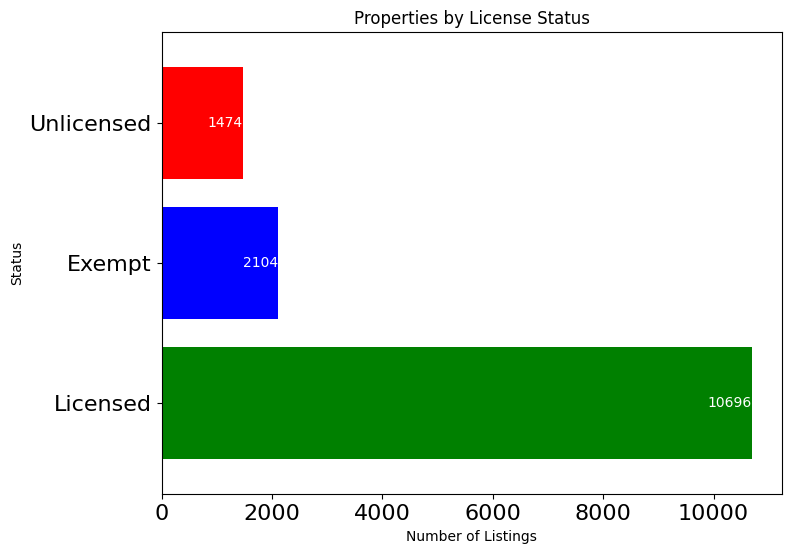

In [83]:
licensed_count = listings['license'].str.startswith("PID-STRA-").sum()
exempt_count = listings['license'].str.startswith("Exempt").sum()


unlicensed_count = listings.shape[0] - licensed_count - exempt_count


counts = pd.Series([licensed_count, exempt_count, unlicensed_count], index=["Licensed", "Exempt", "Unlicensed"])

counts.plot.barh(figsize=(8, 6), width=0.8, color=["g", "b", "r"])


for index, value in enumerate(counts):
    plt.text(value, index, str(value), color = "#ffffff", ha='right', va='center')

plt.title("Properties by License Status")
plt.xlabel("Number of Listings")
plt.ylabel("Status")
plt.show()

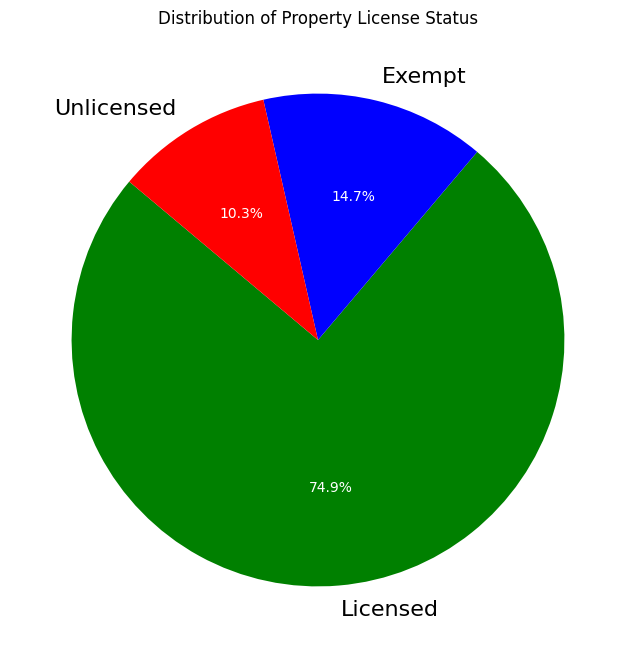

In [84]:
# Assuming counts are calculated as before
licensed_count = listings['license'].str.startswith("PID-STRA-").sum()
exempt_count = listings['license'].str.startswith("Exempt").sum()
unlicensed_count = listings.shape[0] - licensed_count - exempt_count

counts = pd.Series([licensed_count, exempt_count, unlicensed_count], index=["Licensed", "Exempt", "Unlicensed"])

# Create the pie chart and capture returned objects
plt.figure(figsize=(8, 8))
patches, texts, autotexts = plt.pie(counts, labels=counts.index, autopct='%1.1f%%', startangle=140, colors=["green", "blue", "red"])

# Set color of the percentage annotations (autotexts) to white
for autotext in autotexts:
    autotext.set_color('white')

plt.title("Distribution of Property License Status")
plt.show()


According to the law, specific short-term rentals require a license.
Based on the dataset, 74,9% have their official licenses, 14,7% exempt, and the rest of Airbnb properties in Sydney don't own the license.

**Text Mining: Airbnb Reviews**

In [85]:
reviews_details.shape

(499595, 6)

In [86]:
reviews_details = pd.merge(reviews_details, listings[['host_id', 'host_name', 'name']], on = "listing_id", how = "left")
reviews_details = reviews_details.set_index('id')
reviews_details = reviews_details[['listing_id', 'name', 'host_id', 'host_name', 'date', 'reviewer_id', 'reviewer_name', 'comments']]
reviews_details.head()

,listing_id,name,host_id,host_name,date,reviewer_id,reviewer_name,comments
id,,,,,,,,
19220,11156,An Oasis in the City,40855,Colleen,2009-12-05,52946,Jeff,Colleen was friendly and very helpful regardin...
32592,11156,An Oasis in the City,40855,Colleen,2010-03-31,99382,Michael,"Great place, centrally located, easy walk to t..."
42280,11156,An Oasis in the City,40855,Colleen,2010-05-14,105797,Marina,Colleen is very friendly and helpful. The apar...
140942,11156,An Oasis in the City,40855,Colleen,2010-11-17,259213,Sigrid,Dear Colleen!\r<br/>My friend Diemut from Germ...
151966,11156,An Oasis in the City,40855,Colleen,2010-12-11,273389,Eduardo,"Lovely, interesting chats and very helpful giv..."


In [87]:
#the earliest review date and the latest

reviews_details['date'] = pd.to_datetime(reviews_details['date'])

# Find the earliest review date
earliest_date = reviews_details['date'].min()
print("Earliest review date:", earliest_date)

# Find the latest review date
latest_date = reviews_details['date'].max()
print("Latest review date:", latest_date)


Earliest review date: 2009-12-05 00:00:00
Latest review date: 2024-03-18 00:00:00


In [88]:
host_reviews = reviews_details.groupby(['host_id', 'host_name']).size().sort_values(ascending=False).to_frame(name = "number_of_reviews")
host_reviews.head()

,,number_of_reviews
host_id,host_name,
279001183,MadeComfy,5887
24048741,Tommy,2985
270132187,Ween,2888
91961414,Kimi,2749
283498077,Dom,2595


In [89]:
reviews_details.comments.head()

id
19220     Colleen was friendly and very helpful regardin...
32592     Great place, centrally located, easy walk to t...
42280     Colleen is very friendly and helpful. The apar...
140942    Dear Colleen!\r<br/>My friend Diemut from Germ...
151966    Lovely, interesting chats and very helpful giv...
Name: comments, dtype: object

In [90]:
reviews_details.comments.values[2]

'Colleen is very friendly and helpful. The apartment is nice and located conveniently. '

In [91]:
reviews_details = reviews_details[reviews_details['comments'].notnull()]
#reviews_details['comments'] = reviews_details['comments'].str.lower()
# Remove numbers using a raw string for the regex pattern and specifying regex=True
#reviews_details['comments'] = reviews_details['comments'].str.replace(r'\d+', '', regex=True)
#reviews_details['comments'] = reviews_details['comments'].str.replace(r'\r\n', "")
#reviews_details['comments'] = reviews_details['comments'].str.replace(r'[\w\s]'," ")
#reviews_details['comments'] = reviews_details['comments'].str.replace(r'\s+', ' ')

stop_english = stopwords.words("english")
reviews_details['comments'] = reviews_details['comments'].apply(lambda x: " ".join([i for i in x.split() 
                                                      if i not in (stop_english)]))


In [92]:
host_names = reviews_details[['host_name']].drop_duplicates()
host_names = host_names.host_name.str.lower().tolist()


len(host_names)

2856

In [93]:
texts = reviews_details.comments.tolist()

vec = CountVectorizer().fit(texts)
bag_of_words = vec.transform(texts)
sum_words = bag_of_words.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]

cvec_df = pd.DataFrame.from_records(words_freq, columns= ['words', 'counts']).sort_values(by="counts", ascending=False)
cvec_df.head(20)

,words,counts
47,great,265329
70,stay,238605
48,place,207728
9,br,206986
23,the,205991
107,location,184780
387,clean,117004
60,apartment,116873
140,we,115440
39,would,94693


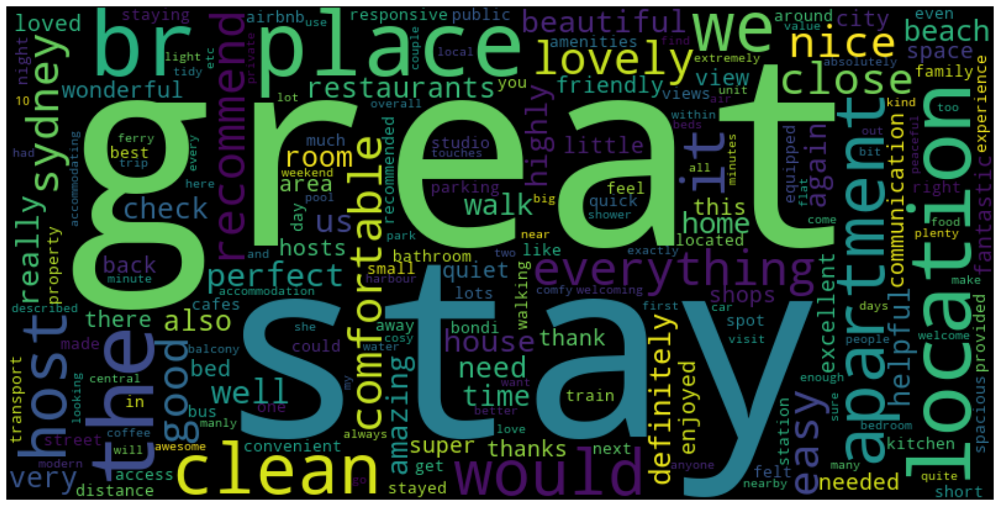

In [94]:
cvec_dict = dict(zip(cvec_df.words, cvec_df.counts))

wordcloud = WordCloud(width=800, height=400)
wordcloud.generate_from_frequencies(frequencies=cvec_dict)
plt.figure( figsize=(20,10) )
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [95]:
def get_top_n_words(n_top_words, count_vectorizer, text_data):

    vectorized_headlines = count_vectorizer.fit_transform(text_data.values)
    vectorized_total = np.sum(vectorized_headlines, axis=0)
    word_indices = np.flip(np.argsort(vectorized_total)[0,:], 1)
    word_values = np.flip(np.sort(vectorized_total)[0,:],1)
    
    word_vectors = np.zeros((n_top_words, vectorized_headlines.shape[1]))
    for i in range(n_top_words):
        word_vectors[i,word_indices[0,i]] = 1

    words = [word[0].encode('ascii').decode('utf-8') for 
             word in count_vectorizer.inverse_transform(word_vectors)]

    return (words, word_values[0,:n_top_words].tolist()[0])

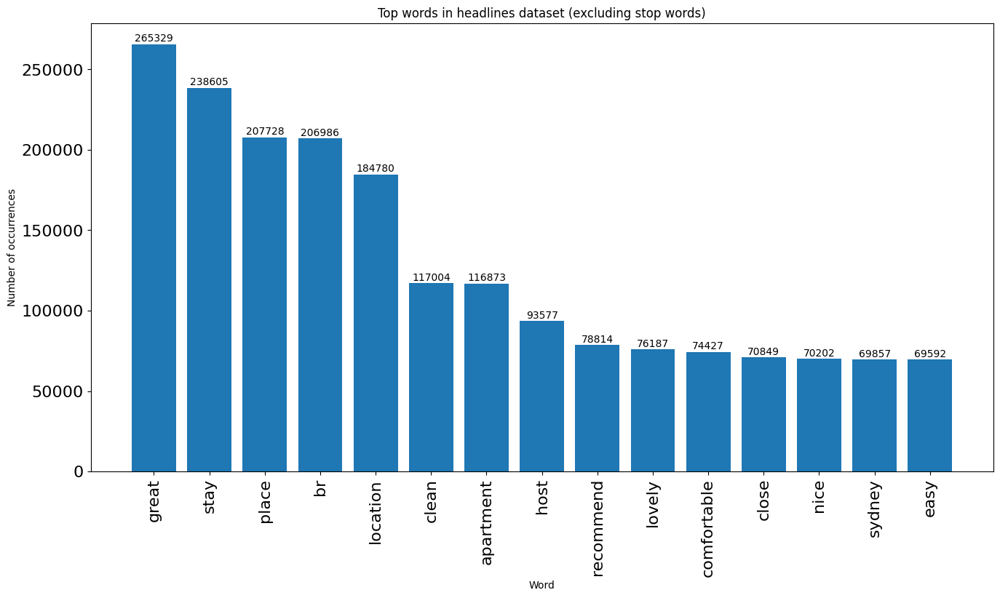

In [96]:
count_vectorizer = CountVectorizer(stop_words='english')
reindexed_data = reviews_details.comments
reindexed_data.index = reviews_details['listing_id']
words, word_values = get_top_n_words(n_top_words=15,
                                     count_vectorizer=count_vectorizer, 
                                     text_data=reindexed_data)

fig, ax = plt.subplots(figsize=(16,8))
bars = ax.bar(range(len(words)), word_values)  # 'bars' is a container of bar objects
ax.set_xticks(range(len(words)))
ax.set_xticklabels(words, rotation='vertical')
ax.set_title('Top words in headlines dataset (excluding stop words)')
ax.set_xlabel('Word')
ax.set_ylabel('Number of occurrences')


for bar in bars:
    height = bar.get_height()  # Get the height of each bar
    ax.text(bar.get_x() + bar.get_width() / 2.,  # x-position
            1.002*height,  # y-position just above the bar
            f'{height}',  # the text to display (the height of the bar)
            ha='center',  # horizontal alignment
            va='bottom')  # vertical alignment

plt.show()

In [97]:
""" tagged_headlines = [TextBlob(text).pos_tags for text in reviews_details.comments] """

' tagged_headlines = [TextBlob(text).pos_tags for text in reviews_details.comments] '

In [98]:
""" tagged_headlines_df = pd.DataFrame({'tags':tagged_headlines})

word_counts = [] 
pos_counts = {}

for headline in tagged_headlines_df[u'tags']:
    word_counts.append(len(headline))
    for tag in headline:
        if tag[1] in pos_counts:
            pos_counts[tag[1]] += 1
        else:
            pos_counts[tag[1]] = 1
            
print('Total number of words: ', np.sum(word_counts))
print('Mean number of words per headline: ', np.mean(word_counts)) """

" tagged_headlines_df = pd.DataFrame({'tags':tagged_headlines})\n\nword_counts = [] \npos_counts = {}\n\nfor headline in tagged_headlines_df[u'tags']:\n    word_counts.append(len(headline))\n    for tag in headline:\n        if tag[1] in pos_counts:\n            pos_counts[tag[1]] += 1\n        else:\n            pos_counts[tag[1]] = 1\n            \nprint('Total number of words: ', np.sum(word_counts))\nprint('Mean number of words per headline: ', np.mean(word_counts)) "

In [99]:
""" y = stats.norm.pdf(np.linspace(0,14,50), np.mean(word_counts), np.std(word_counts))

fig, ax = plt.subplots(figsize=(18,8))
ax.hist(word_counts, bins=range(1,14),linewidth=0.5, edgecolor="white", density=True);
ax.plot(np.linspace(0,14,50), y, 'r--', linewidth=1);
ax.set_title('Headline word lengths');
ax.set_xticks(range(1,14));
ax.tick_params(axis='x', rotation=90)
ax.set_xlabel('Number of words');
plt.show() """

' y = stats.norm.pdf(np.linspace(0,14,50), np.mean(word_counts), np.std(word_counts))\n\nfig, ax = plt.subplots(figsize=(18,8))\nax.hist(word_counts, bins=range(1,14),linewidth=0.5, edgecolor="white", density=True);\nax.plot(np.linspace(0,14,50), y, \'r--\', linewidth=1);\nax.set_title(\'Headline word lengths\');\nax.set_xticks(range(1,14));\nax.tick_params(axis=\'x\', rotation=90)\nax.set_xlabel(\'Number of words\');\nplt.show() '

In [100]:
""" pos_sorted_types = sorted(pos_counts, key=pos_counts.__getitem__, reverse=True)
pos_sorted_counts = sorted(pos_counts.values(), reverse=True)

fig, ax = plt.subplots(figsize=(18,8))
ax.bar(range(len(pos_counts)), pos_sorted_counts);
ax.set_xticks(range(len(pos_counts)));
ax.set_xticklabels(pos_sorted_types);
ax.set_title('Part-of-Speech Tagging for Headlines Corpus');
ax.set_xlabel('Type of Word'); """

" pos_sorted_types = sorted(pos_counts, key=pos_counts.__getitem__, reverse=True)\npos_sorted_counts = sorted(pos_counts.values(), reverse=True)\n\nfig, ax = plt.subplots(figsize=(18,8))\nax.bar(range(len(pos_counts)), pos_sorted_counts);\nax.set_xticks(range(len(pos_counts)));\nax.set_xticklabels(pos_sorted_types);\nax.set_title('Part-of-Speech Tagging for Headlines Corpus');\nax.set_xlabel('Type of Word'); "

In [101]:
""" small_count_vectorizer = CountVectorizer(stop_words='english', max_features=40000)
small_text_sample = reindexed_data.sample(n=10000, random_state=0).values

print('Headline before vectorization: {}'.format(small_text_sample[123]))

small_document_term_matrix = small_count_vectorizer.fit_transform(small_text_sample)

print('Headline after vectorization: \n{}'.format(small_document_term_matrix[123])) """

" small_count_vectorizer = CountVectorizer(stop_words='english', max_features=40000)\nsmall_text_sample = reindexed_data.sample(n=10000, random_state=0).values\n\nprint('Headline before vectorization: {}'.format(small_text_sample[123]))\n\nsmall_document_term_matrix = small_count_vectorizer.fit_transform(small_text_sample)\n\nprint('Headline after vectorization: \n{}'.format(small_document_term_matrix[123])) "

In [102]:
""" n_topics = 10 """

' n_topics = 10 '

In [103]:
""" lsa_model = TruncatedSVD(n_components=n_topics)
lsa_topic_matrix = lsa_model.fit_transform(small_document_term_matrix) """

' lsa_model = TruncatedSVD(n_components=n_topics)\nlsa_topic_matrix = lsa_model.fit_transform(small_document_term_matrix) '

In [104]:
""" # Define helper functions
def get_keys(topic_matrix):
    '''
    returns an integer list of predicted topic 
    categories for a given topic matrix
    '''
    keys = topic_matrix.argmax(axis=1).tolist()
    return keys

def keys_to_counts(keys):
    '''
    returns a tuple of topic categories and their 
    accompanying magnitudes for a given list of keys
    '''
    count_pairs = Counter(keys).items()
    categories = [pair[0] for pair in count_pairs]
    counts = [pair[1] for pair in count_pairs]
    return (categories, counts) """

" # Define helper functions\ndef get_keys(topic_matrix):\n    '''\n    returns an integer list of predicted topic \n    categories for a given topic matrix\n    '''\n    keys = topic_matrix.argmax(axis=1).tolist()\n    return keys\n\ndef keys_to_counts(keys):\n    '''\n    returns a tuple of topic categories and their \n    accompanying magnitudes for a given list of keys\n    '''\n    count_pairs = Counter(keys).items()\n    categories = [pair[0] for pair in count_pairs]\n    counts = [pair[1] for pair in count_pairs]\n    return (categories, counts) "

In [105]:
""" lsa_keys = get_keys(lsa_topic_matrix)
lsa_categories, lsa_counts = keys_to_counts(lsa_keys) """

' lsa_keys = get_keys(lsa_topic_matrix)\nlsa_categories, lsa_counts = keys_to_counts(lsa_keys) '